In [24]:
import cv2 as cv
import numpy as np
import imutils
import matplotlib.pyplot as plt

# 2 неделя

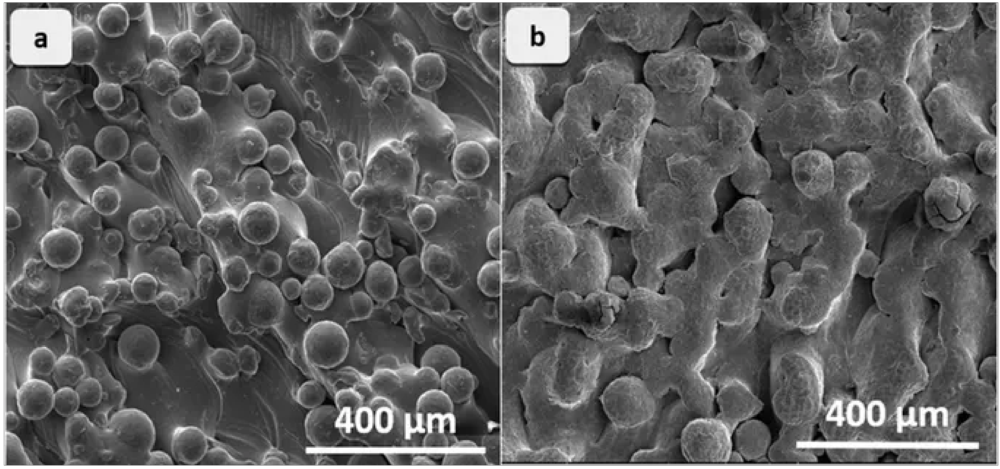

In [25]:
img = cv.imread('/Users/liyakul/Desktop/proekt/microphoto.jpg')
print_image(img)
# нашла картинку в интернете 

In [26]:
def print_image(image):
    plt.figure(figsize=(50, 50))
    plt.subplot(),plt.imshow(image)
    plt.xticks([]),plt.yticks([])
    plt.show()

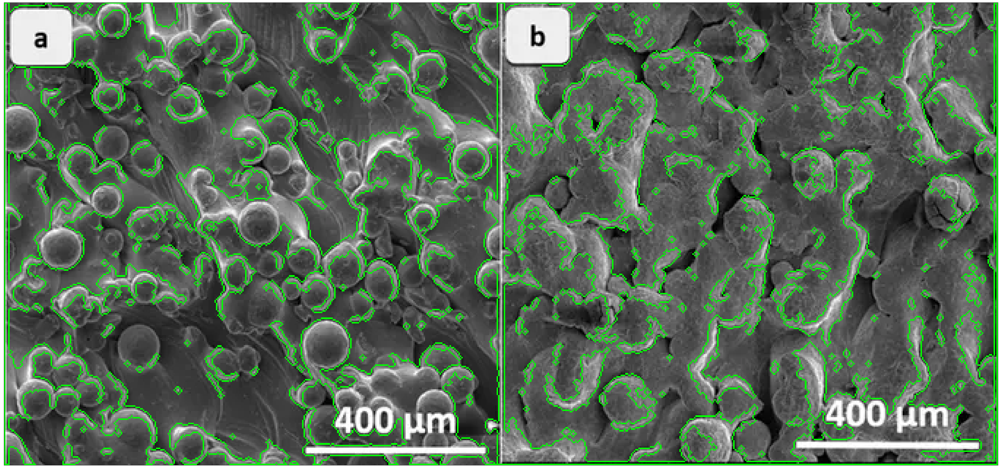

In [27]:
clone3 = img.copy()
gray = cv.cvtColor(clone3, cv.COLOR_BGR2GRAY)
ret, thresh = cv.threshold(gray, 127, 255, 0)
bil = cv.bilateralFilter(thresh, 5, 175, 175)
contours, hierarchy = cv.findContours(bil, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_NONE)
cv.drawContours(clone3, contours, -1, (0,255,0), 1)
print_image(clone3)

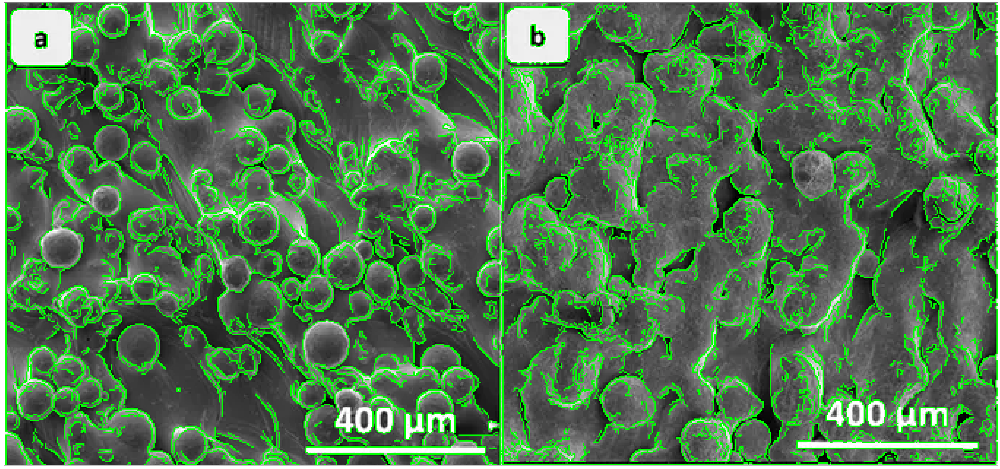

In [36]:
clone3 = img.copy()
gray2 = cv.cvtColor(clone3, cv.COLOR_BGR2GRAY)
ret, thresh = cv.threshold(gray, 127, 255, 0)
contours, hierarchy = cv.findContours(thresh, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_NONE)
cv.drawContours(clone3, contours, -1, (0,255,0), 1)
print_image(clone3)

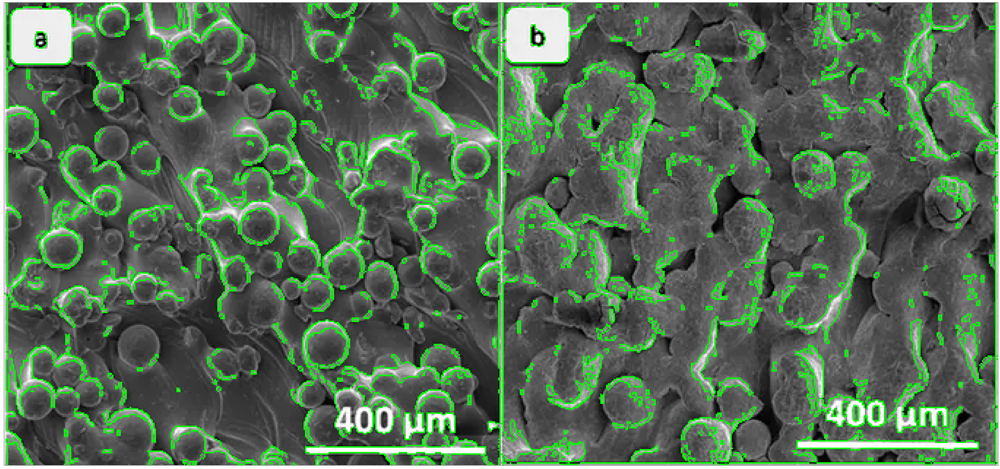

In [37]:
clone3 = img.copy()
gray = cv.cvtColor(clone3, cv.COLOR_BGR2GRAY)
ret, thresh = cv.threshold(gray, 127, 255, 0)
bil = cv.bilateralFilter(thresh, 5, 175, 175)
edge = cv.Canny(bil, 75, 200)
contours, hierarchy = cv.findContours(edge, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_NONE)
cv.drawContours(clone3, contours, -1, (0,255,0), 1)
print_image(clone3)

Почему-то в каждом способе граница шаров определяется только частично. Хотя визуально вся граница одного светло-серого цвета. Пока что я ищу способ, с помощью которого будут определяться все границы.

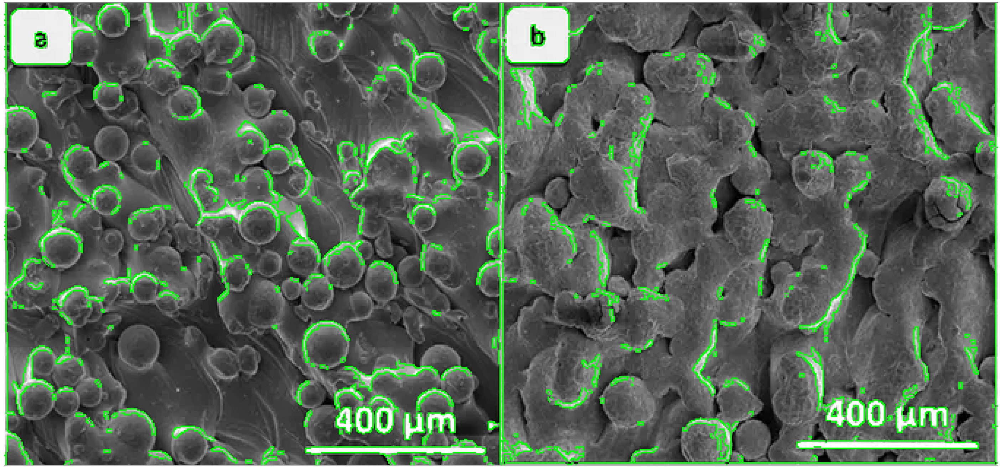

In [30]:
# if img.shape[1] > 600:
#     img = imutils.resize(img, width=600)
# clone = img.copy()

# if img.shape[1] > 600:
#     img = imutils.resize(img, width=600)
clone = img.copy()
 
# Convert to grayscale
gray = cv.cvtColor(clone, cv.COLOR_BGR2GRAY)
 
# Threshold grayscaled image to get binary image
ret,gray_threshed = cv.threshold(gray,150,255,cv.THRESH_BINARY)
 
# Smooth an image
bilateral_filtered_image = cv.bilateralFilter(gray_threshed, 5, 175, 175)
 
# Find edges
edge_detected_image = cv.Canny(bilateral_filtered_image, 100, 200)
 
# Find contours
contours, _= cv.findContours(edge_detected_image, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)
 
contour_list = []
for contour in contours:
    approx = cv.approxPolyDP(contour,0.01*cv.arcLength(contour,True),True)
    area = cv.contourArea(contour)
#     if ((len(approx) > 8) & (50000 > area > 10000) ):
    contour_list.append(contour)

cv.drawContours(clone, contours, -1, (0,255,0), 1)
print_image(clone)




Отличие от предыдущего - изменяем параметры и рисуем не все контуры. Это позволило убрать ненужные границы, не относящие к шарам.

Попробуем другой способ

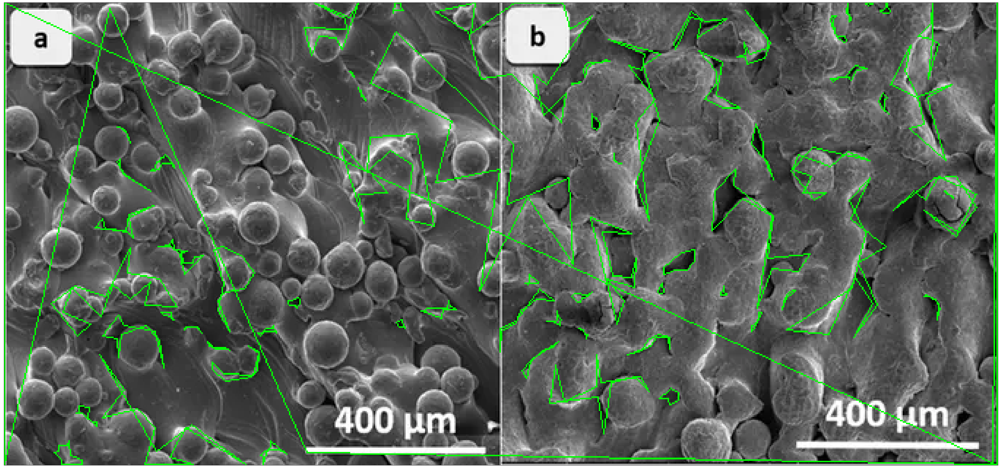

In [38]:
src = img.copy()
gr = cv.cvtColor(src, cv.COLOR_BGR2GRAY)
bl = cv.medianBlur(gr, 5)
canny = cv.Canny(bl, 100, 200)
kernel = cv.getStructuringElement(cv.MORPH_RECT, (7, 7))
closed = cv.morphologyEx(canny, cv.MORPH_CLOSE, kernel)
contours2 = cv.findContours(closed.copy(), cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)[0]
for cont in contours2:
        #сглаживание и определение количества углов
        sm = cv.arcLength(cont, True)
        apd = cv.approxPolyDP(cont, 0.02*sm, True)
        #выделение контуров
#         if len(apd) == 8:
        cv.drawContours(src, [apd], -1, (0,255,0), 1)
print_image(src)
# почему-то все пошло не по плану

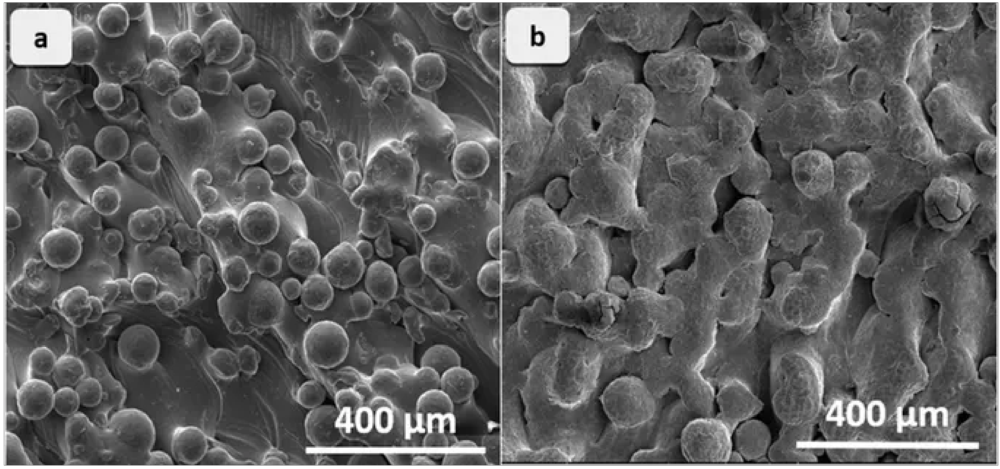

In [12]:
# clone2 = img.copy()
# gray = cv.CreateImage(cv.GetSize(clone2), 8, 1)
# edges = cv.CreateImage(cv.GetSize(clone2), 8, 1)
# cv.CvtColor(clone2, gray, cv.CV_BGR2GRAY)
# cv.Canny(gray, edges, 50, 200, 3)
# cv.Smooth(gray, gray, cv.CV_GAUSSIAN, 9, 9)
# storage = cv.CreateMat(clone2.rows, 1, cv.CV_32FC3)
# cv.HoughCircles(edges, storage, cv.CV_HOUGH_GRADIENT, 2, gray.height/4, 200, 100)

hsv_min = np.array((0, 77, 17), np.uint8)
hsv_max = np.array((208, 255, 255), np.uint8)
clone2 = img.copy()
hsv = cv.cvtColor(clone2, cv.COLOR_BGR2HSV )
thresh = cv.inRange( hsv, hsv_min, hsv_max )
contours0, hierarchy  = cv.findContours(thresh.copy(), cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)
for cnt in contours0:
#     if len(cnt)>4:
    ellipse = cv.fitEllipse(cnt)
    cv.ellipse(clone2,ellipse,(0,0,255),2)


print_image(clone2)
# этот способ вообще не работает

Я решила объединить то, что получилось, в отдельную функцию и применить к какому-то другому изображению

In [13]:
def find_countours(path):
    img_ = cv.imread(path)
    clone_ = img_.copy()
    gray_ = cv.cvtColor(clone_, cv.COLOR_BGR2GRAY)
    ret_, thresh_ = cv.threshold(gray_, 127, 255, 0)
    bil_ = cv.bilateralFilter(thresh_, 5, 175, 175)
    contours_, hierarchy_ = cv.findContours(bil_, cv.RETR_TREE, cv.CHAIN_APPROX_NONE)
    cv.drawContours(clone_, contours_, -1, (0,255,0), 1)
    print_image(clone_)
    
    clone_ = img_.copy()
    gray_ = cv.cvtColor(clone_, cv.COLOR_BGR2GRAY)
    ret_, thresh_ = cv.threshold(gray_, 127, 255, 0)
    contours_, hierarchy_ = cv.findContours(thresh_, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_NONE)
    cv.drawContours(clone_, contours_, -1, (0,255,0), 1)
    print_image(clone_)
    
    clone_ = img_.copy()
    gray_ = cv.cvtColor(clone_, cv.COLOR_BGR2GRAY)
    ret_, thresh_ = cv.threshold(gray_, 127, 255, 0)
    bil_ = cv.bilateralFilter(thresh_, 5, 175, 175)
    edge_ = cv.Canny(bil_, 75, 200)
    contours_, hierarchy_ = cv.findContours(edge_, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_NONE)
    cv.drawContours(clone_, contours_, -1, (0,255,0), 1)
    print_image(clone_)

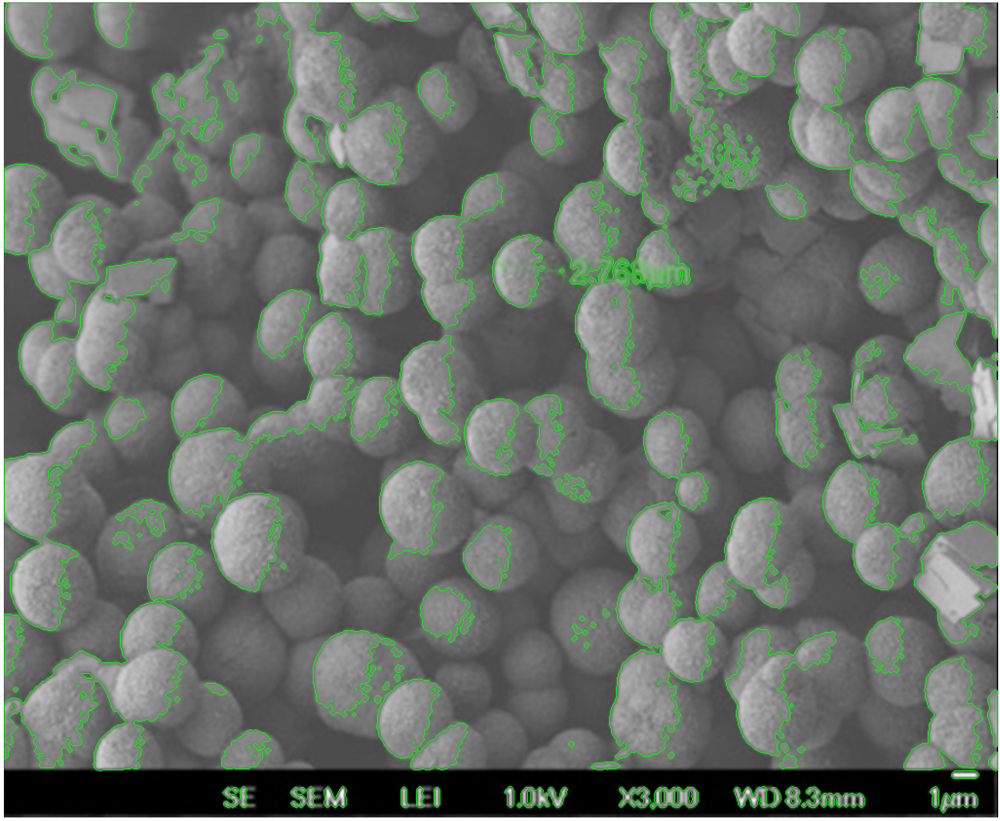

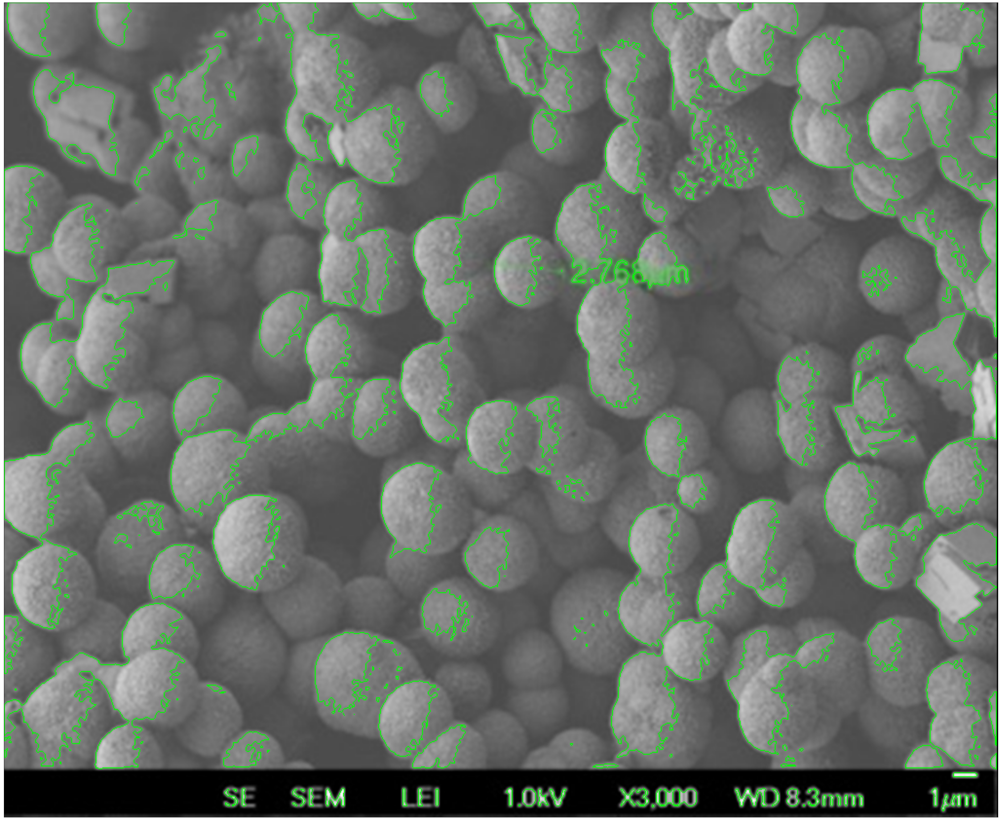

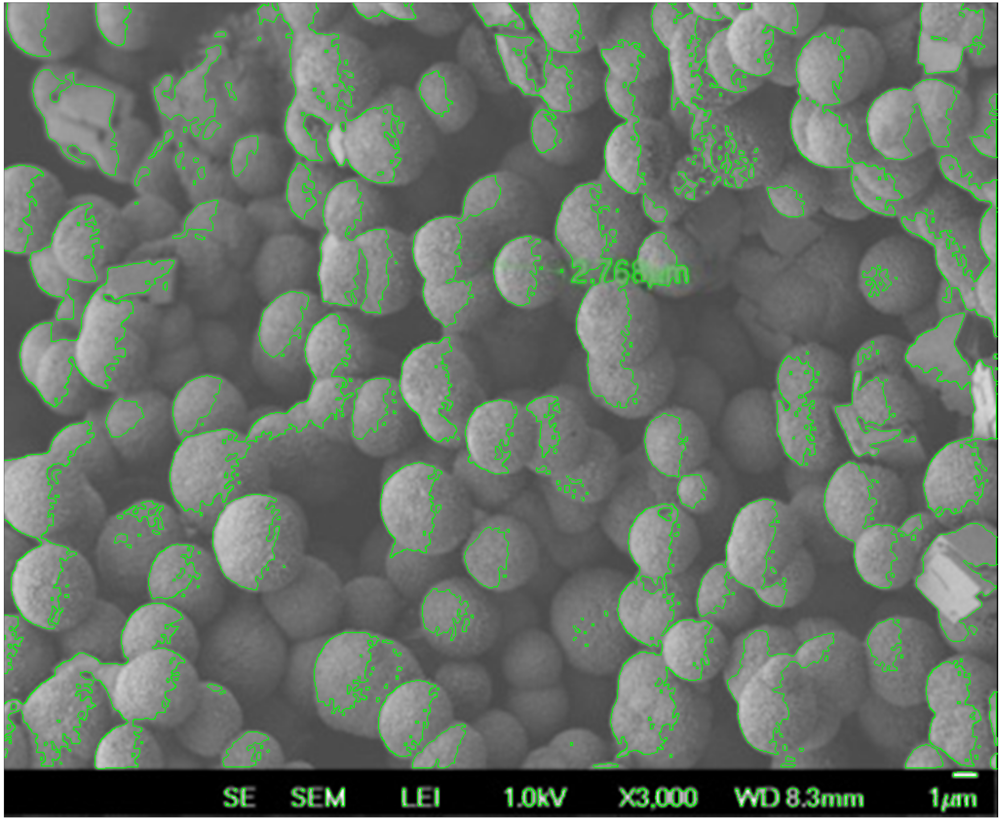

In [141]:
find_countours('/Users/liyakul/Desktop/proekt/microphoto2.png')

На этой картинке cv вообще подвел. Попробуем что-нибудь еще

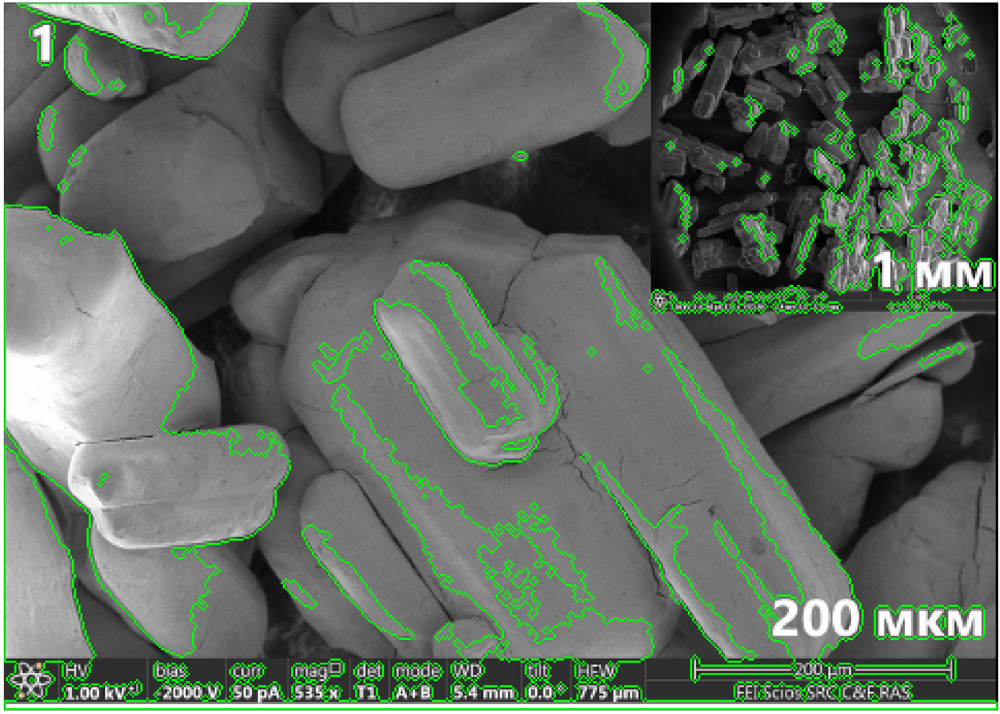

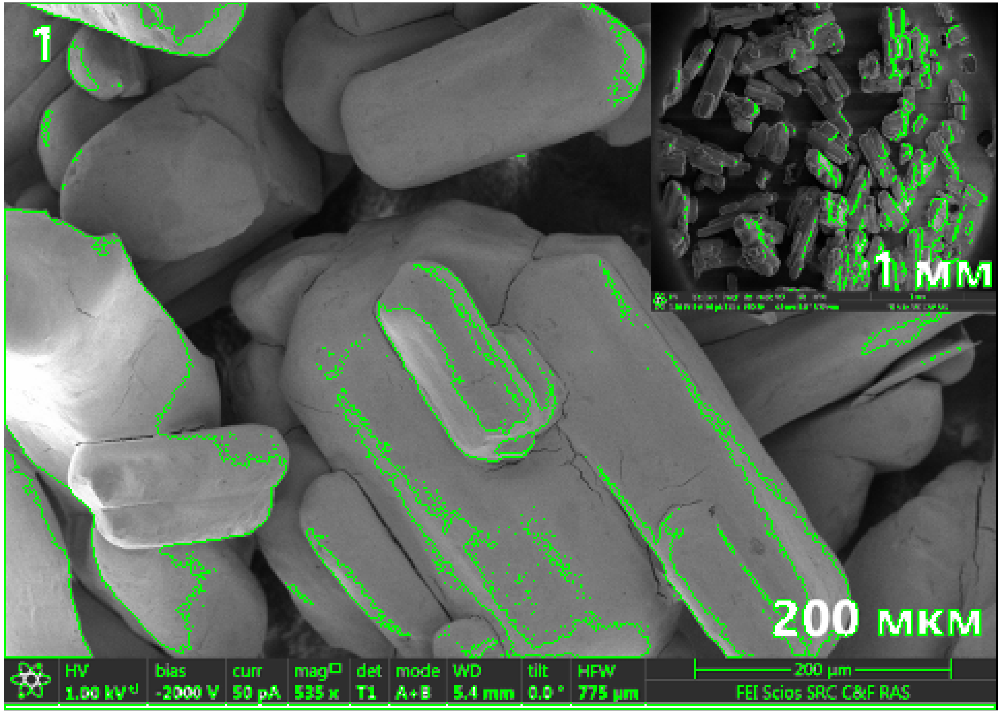

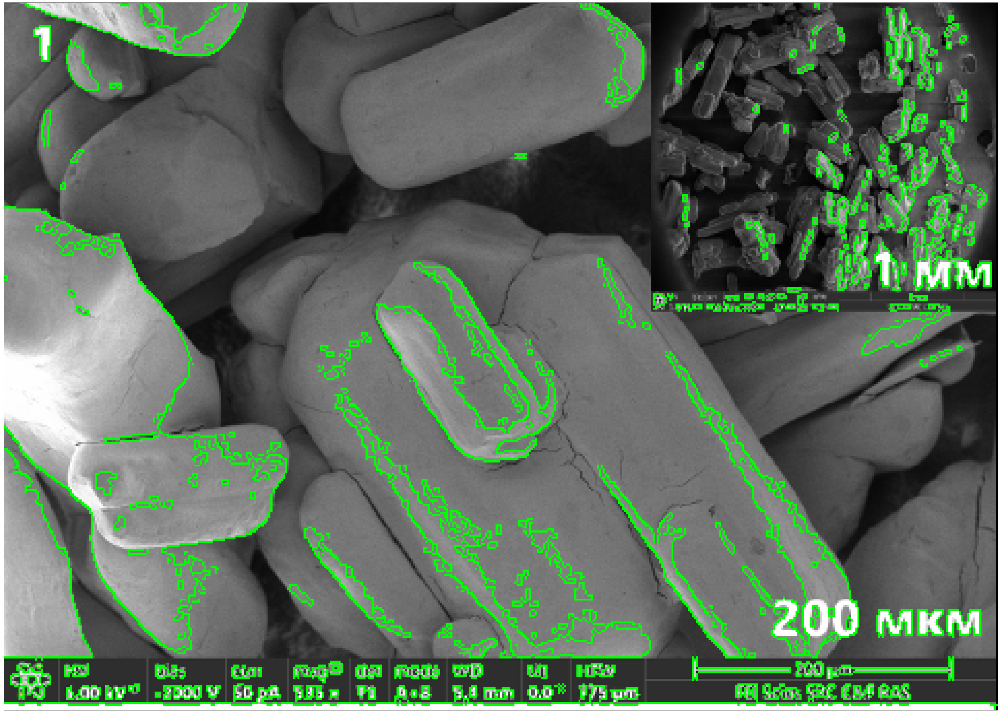

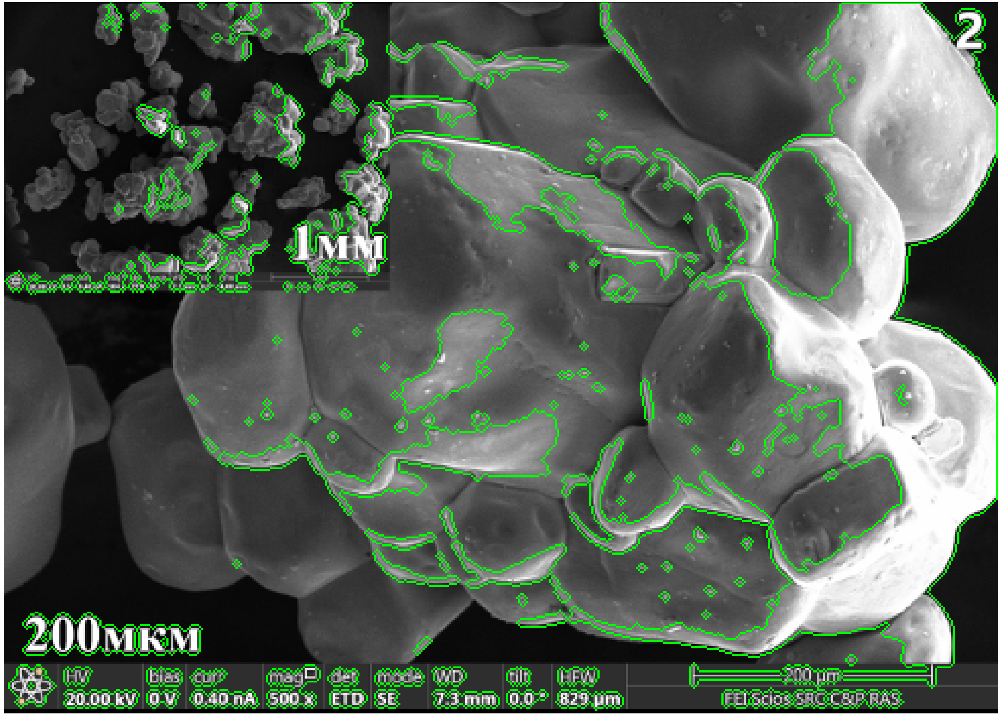

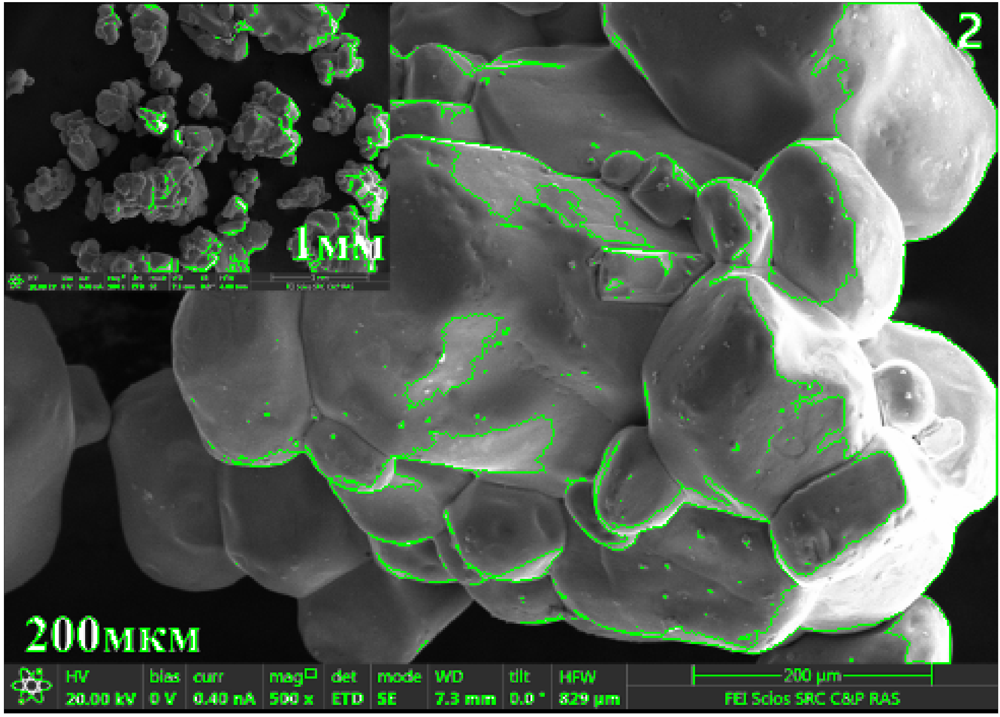

...

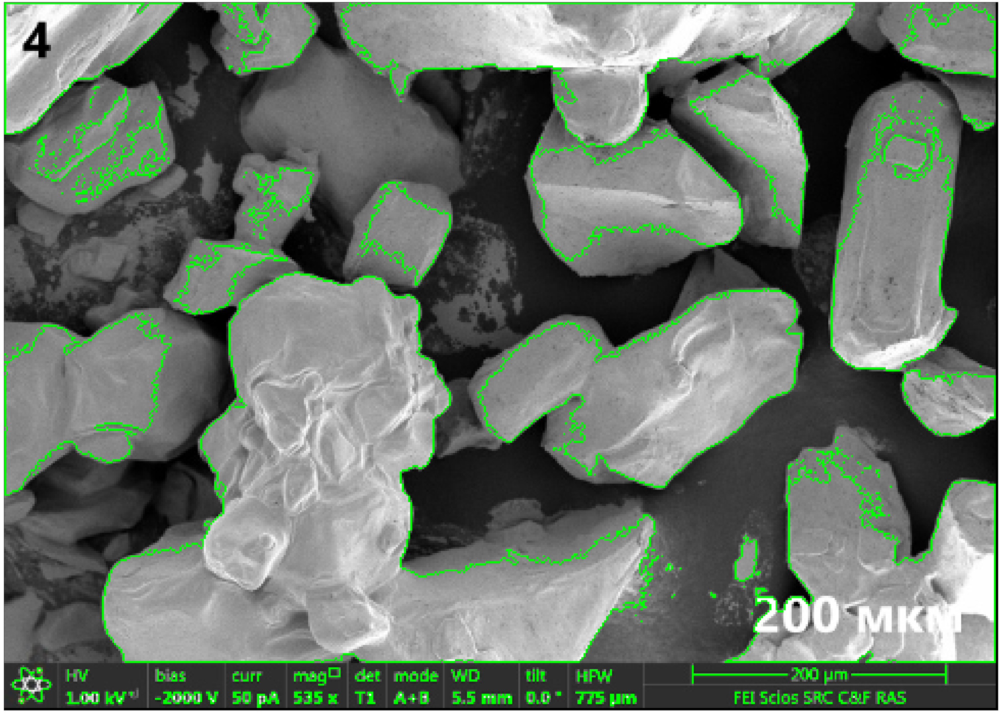

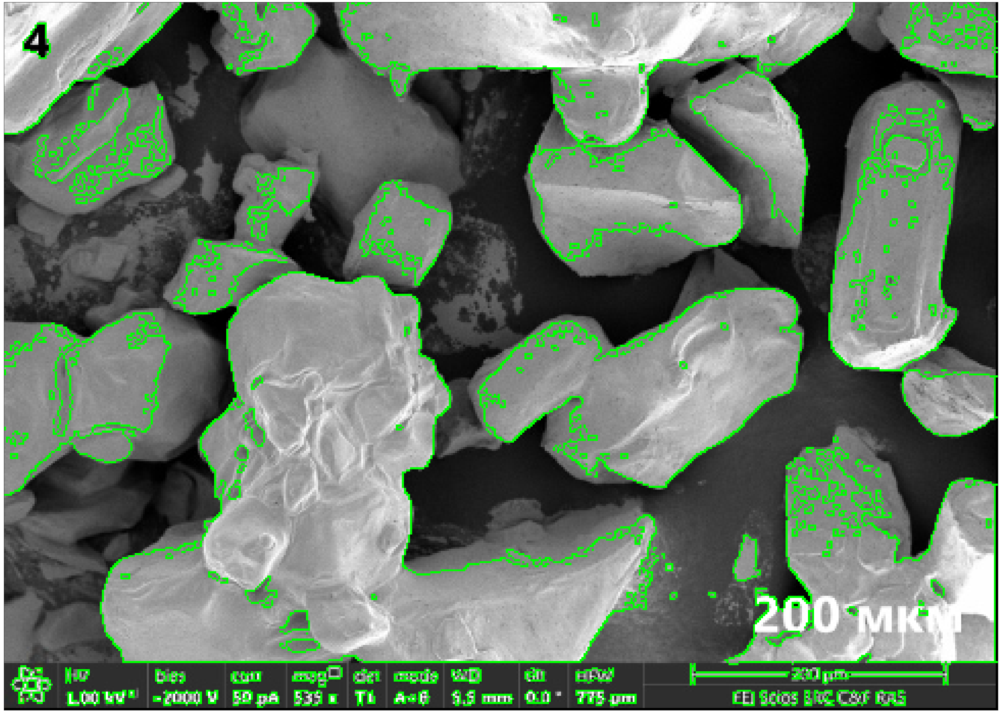

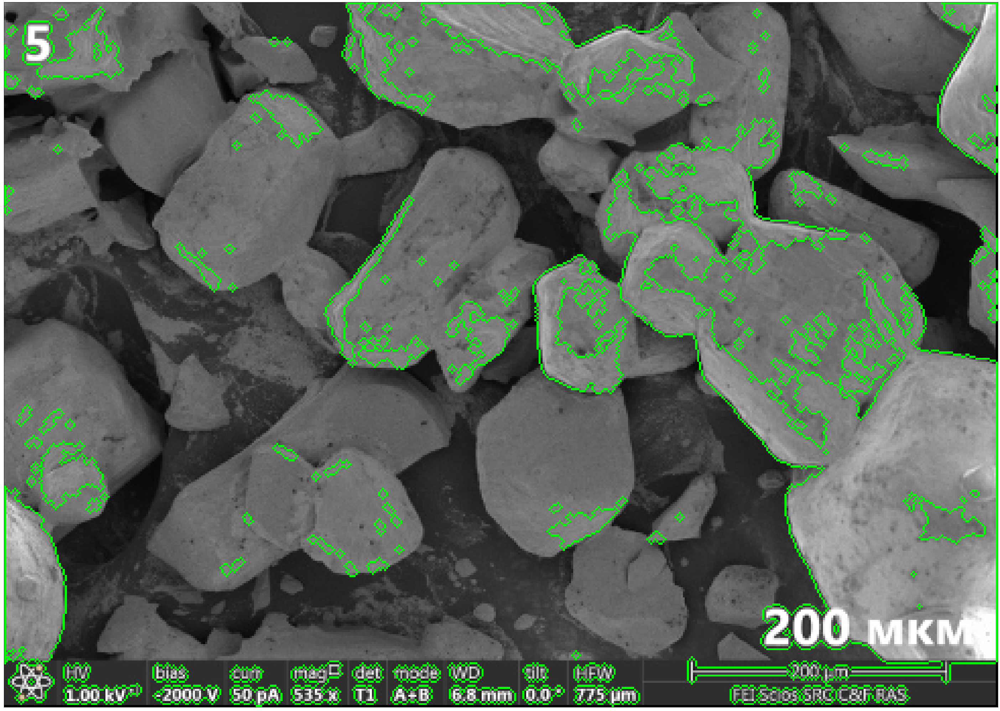

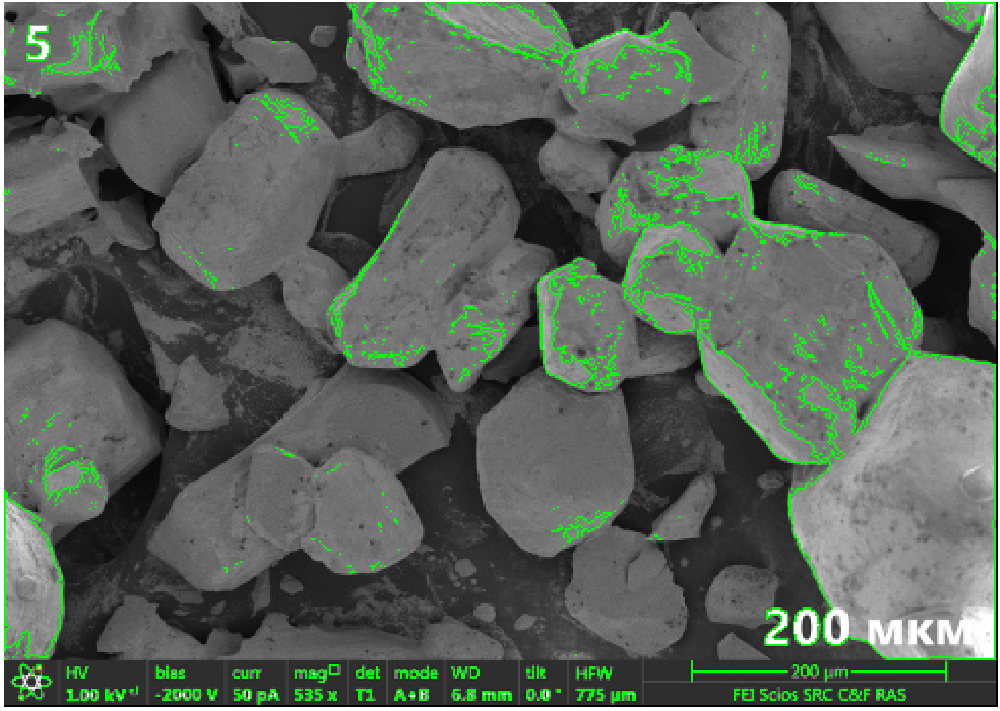

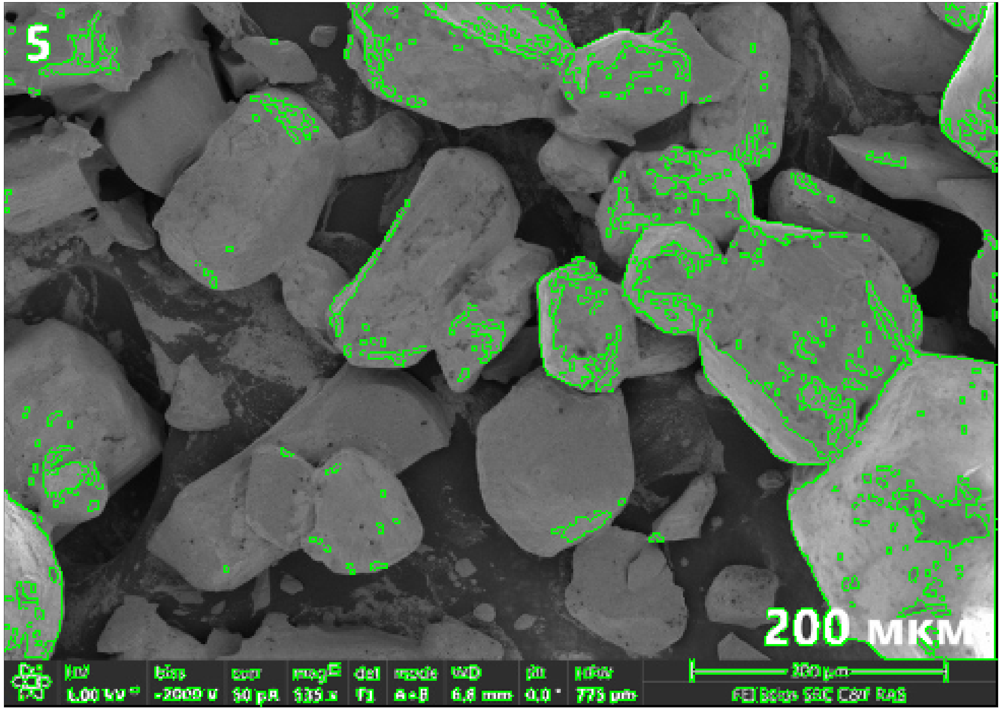

In [14]:
find_countours('/Users/liyakul/Desktop/proekt/microphoto3.png')
find_countours('/Users/liyakul/Desktop/proekt/microphoto4.png')
find_countours('/Users/liyakul/Desktop/proekt/microphoto5.png')
find_countours('/Users/liyakul/Desktop/proekt/microphoto6.png')
find_countours('/Users/liyakul/Desktop/proekt/microphoto7.png')

Как видно, удачно получилось выделить контуры только на одной фотографии :( Проблема в том, что программа выделяет участки одного цвета. В основном, это блики(?) на структурах. Почему она не видит часть структур, которые явно отличаются по цвету от фона? В документации очень мало написано об используемых функциях. Придется поискать еще несколько новых источников.

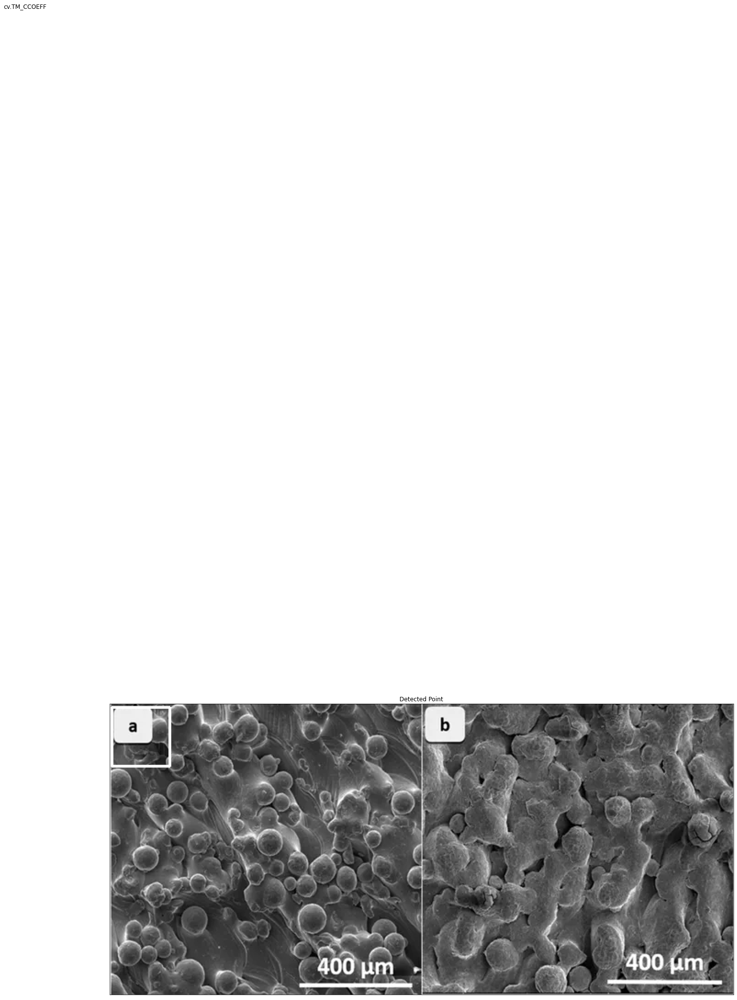

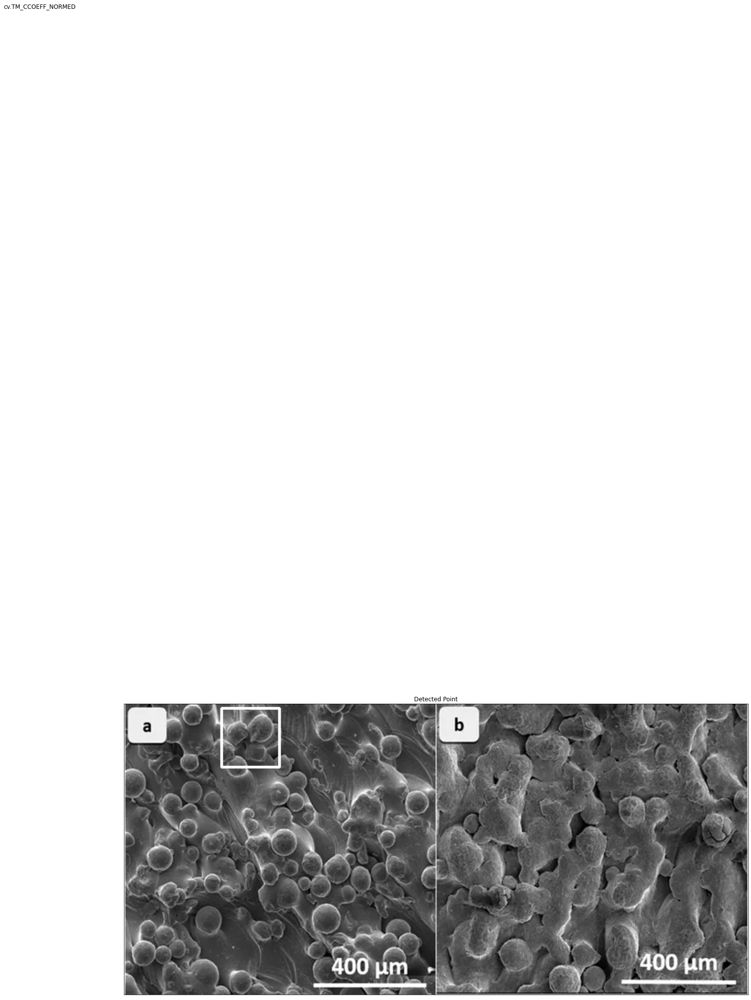

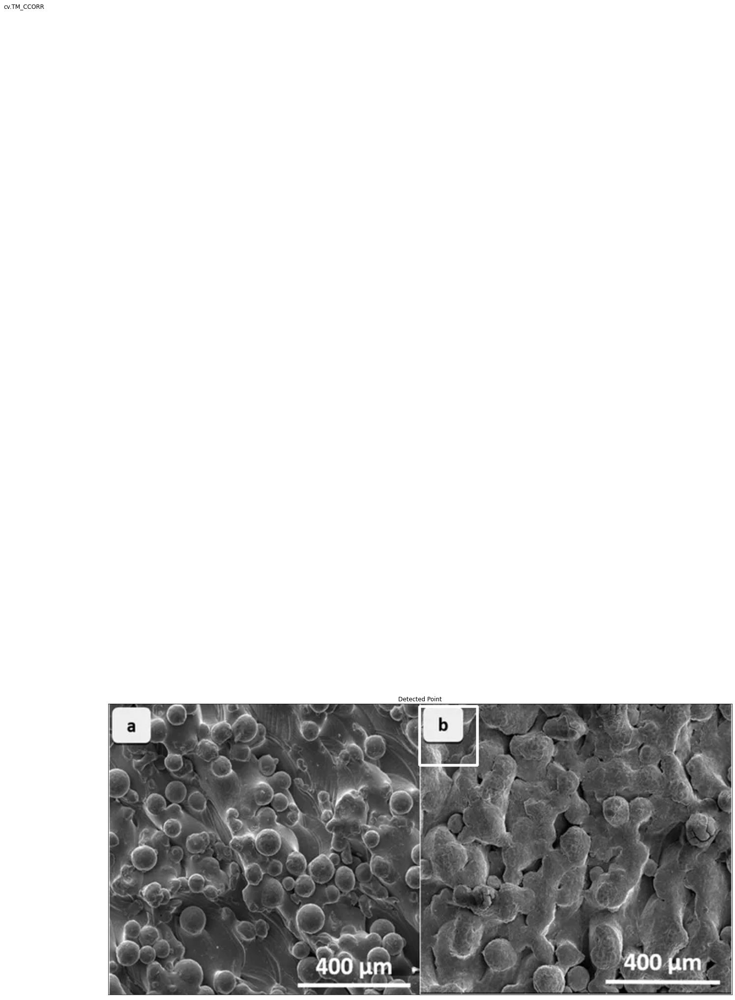

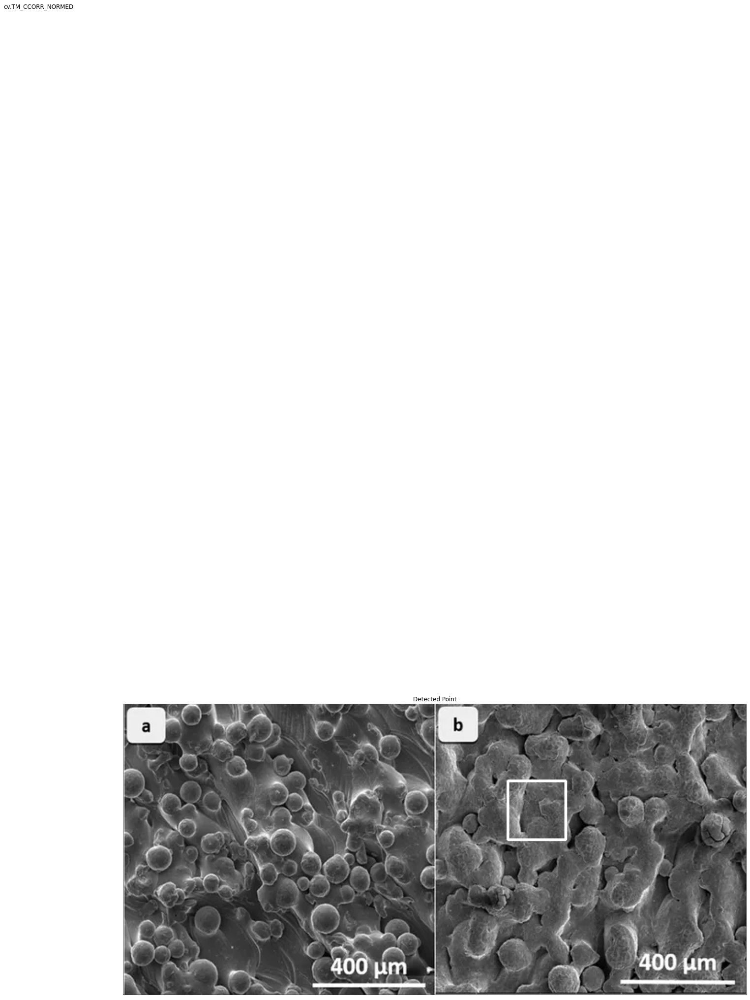

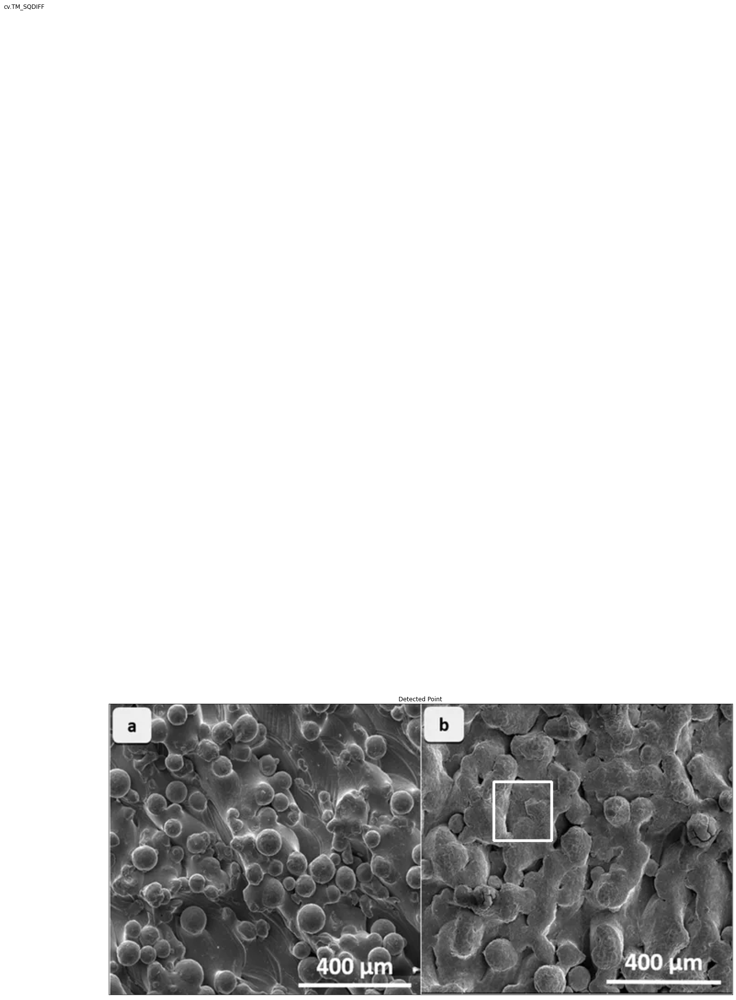

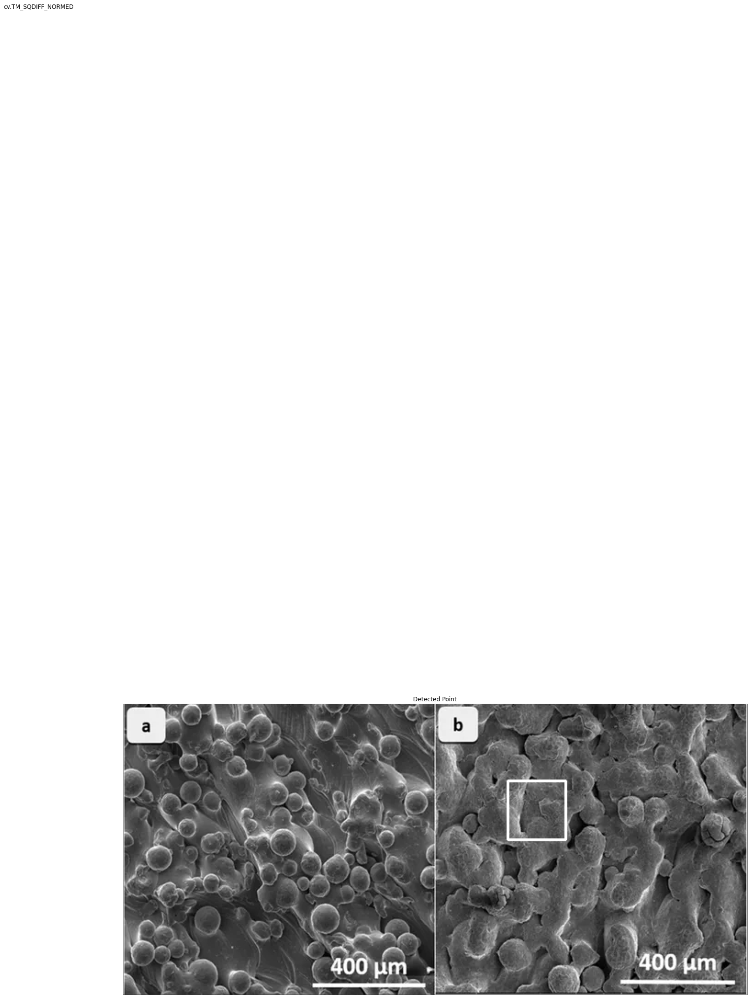

In [170]:
img0 = cv.imread('/Users/liyakul/Desktop/proekt/microphoto.jpg',0)
img2 = img0.copy()
template = cv.imread('/Users/liyakul/Desktop/proekt/obrazec1.png',0)
w, h = template.shape[::-1]
# All the 6 methods for comparison in a list
methods = ['cv.TM_CCOEFF', 'cv.TM_CCOEFF_NORMED', 'cv.TM_CCORR',
            'cv.TM_CCORR_NORMED', 'cv.TM_SQDIFF', 'cv.TM_SQDIFF_NORMED']
for meth in methods:
    img0 = img2.copy()
    method = eval(meth)
    # Apply template Matching
    res = cv.matchTemplate(img0, template, method)
    min_val, max_val, min_loc, max_loc = cv.minMaxLoc(res)
    # If the method is TM_SQDIFF or TM_SQDIFF_NORMED, take minimum
    if method in [cv.TM_SQDIFF, cv.TM_SQDIFF_NORMED]:
        top_left = min_loc
    else:
        top_left = max_loc
    bottom_right = (top_left[0] + w, top_left[1] + h)
    cv.rectangle(img0,top_left, bottom_right, 255, 2)
    plt.figure(figsize=(50, 50))
    plt.subplot(122),plt.imshow(res,cmap = 'gray')
    plt.title('Matching Result'), plt.xticks([]), plt.yticks([])
    plt.subplot(122),plt.imshow(img0,cmap = 'gray')
    plt.title('Detected Point'), plt.xticks([]), plt.yticks([])
    plt.suptitle(meth)
    plt.show()

Смысл этого способа заключается в том, что мы передаем ему шаблон, который программа ищет на фото. Я взяла шаблон с этого же фото. Более-менее справился только один способ поиска. Но здесь он ищет ровно одно вхождение шаблона. Следующий код должен найти все.

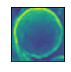

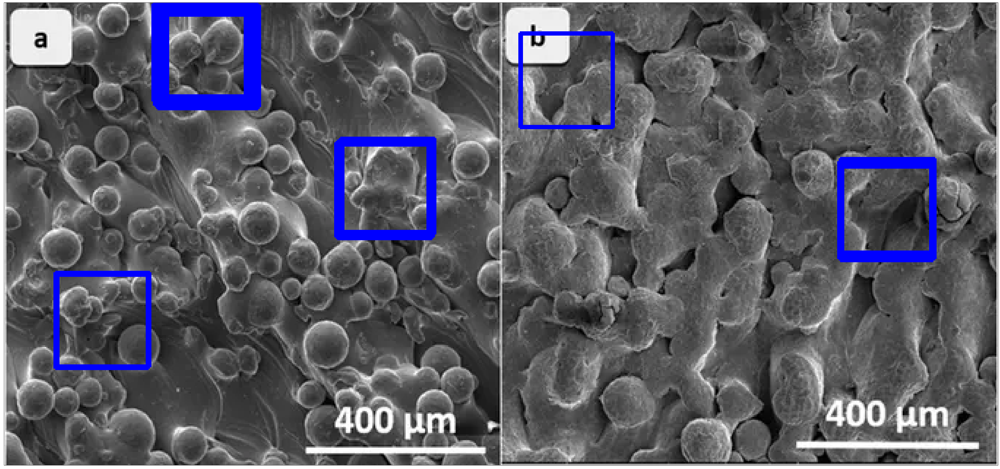

In [207]:
# threshold = 0.35
img_rgb = cv.imread('/Users/liyakul/Desktop/proekt/microphoto.jpg')
img_gray = cv.cvtColor(img_rgb, cv.COLOR_BGR2GRAY, 0)
template = cv.imread('/Users/liyakul/Desktop/proekt/obrazec1.png', 0)
w, h = template.shape[::-1]
res = cv.matchTemplate(img_gray,template,cv.TM_CCOEFF_NORMED)
threshold = 0.37
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv.rectangle(img_rgb, pt, (pt[0] + w, pt[1] + h), (0,0,255), 2)

    
plt.figure(figsize=(1, 1))
plt.subplot(),plt.imshow(template)
plt.xticks([]),plt.yticks([])
plt.show()
print_image(img_rgb)

Подбором константы treshold, программа начала выделять какие-то участки, но опять это не совсем то, что нужно. Минус этого способа в том, что для поиска объектов программе нужно передавать шаблон. Это затрудняет поиск объекта на различных фотографиях, которые пользователь передает программе. Возможно, стоит делать так, чтобы сам пользователь выбирал шаблон на фото, но есть вероятность, что это реализовать намного сложнее, чем доработать первый способ (в начале notebooka). С другой стороны, это сразу дает нам объекты выбранного размера, что является одной из задач.

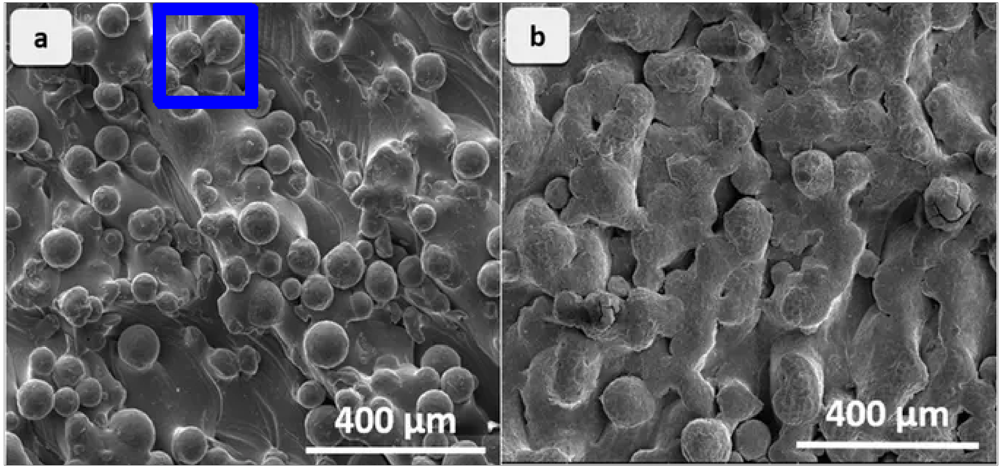

In [185]:
# treshold = 0.4
img_rgb = cv.imread('/Users/liyakul/Desktop/proekt/microphoto.jpg')
img_gray = cv.cvtColor(img_rgb, cv.COLOR_BGR2GRAY)
template = cv.imread('/Users/liyakul/Desktop/proekt/obrazec1.png',0)
w, h = template.shape[::-1]
res = cv.matchTemplate(img_gray,template,cv.TM_CCOEFF_NORMED)
threshold = 0.4
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv.rectangle(img_rgb, pt, (pt[0] + w, pt[1] + h), (0,0,255), 2)
print_image(img_rgb)

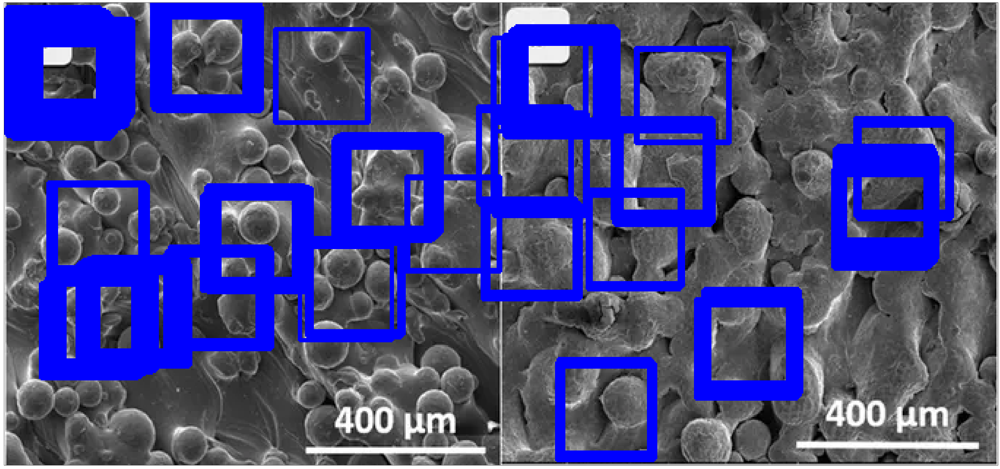

In [186]:
# treshold = 0.3
img_rgb = cv.imread('/Users/liyakul/Desktop/proekt/microphoto.jpg')
img_gray = cv.cvtColor(img_rgb, cv.COLOR_BGR2GRAY)
template = cv.imread('/Users/liyakul/Desktop/proekt/obrazec1.png',0)
w, h = template.shape[::-1]
res = cv.matchTemplate(img_gray,template,cv.TM_CCOEFF_NORMED)
threshold = 0.3
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv.rectangle(img_rgb, pt, (pt[0] + w, pt[1] + h), (0,0,255), 2)
print_image(img_rgb)

На этом моменте я поняла, что стоит побольше узнать о treshhold, поэтому посмотрела в документацию cv.threshold и cv.adaptiveThreshold. Возможно, именно в этом была проблема первого способа. 
Simple thresholding:

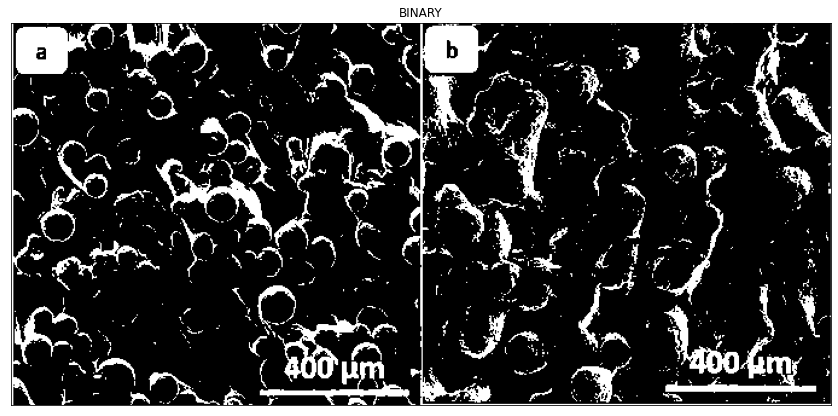

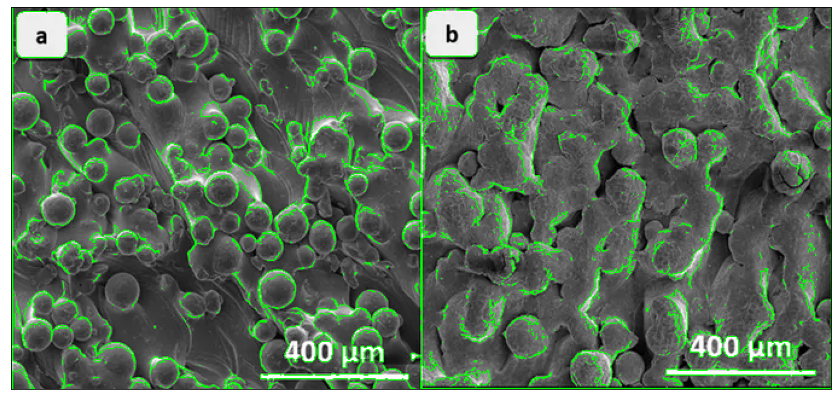

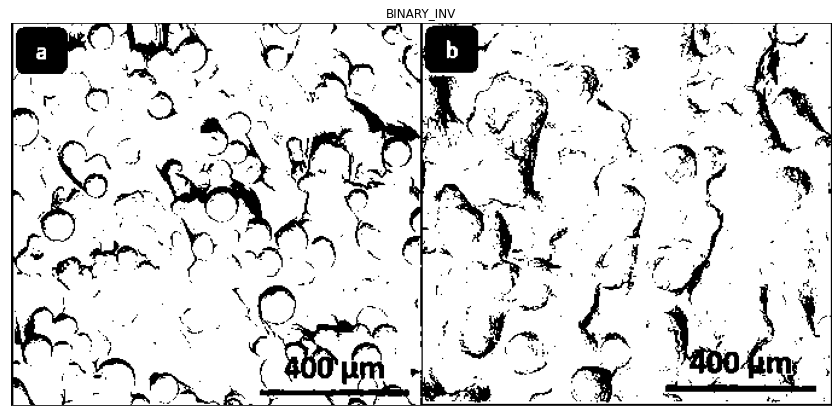

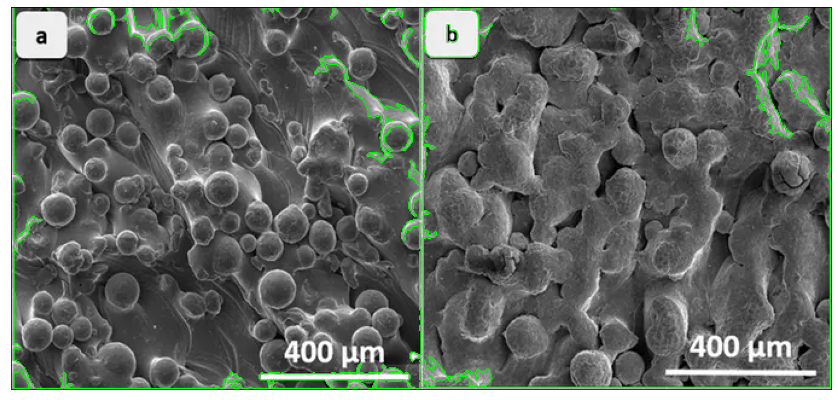

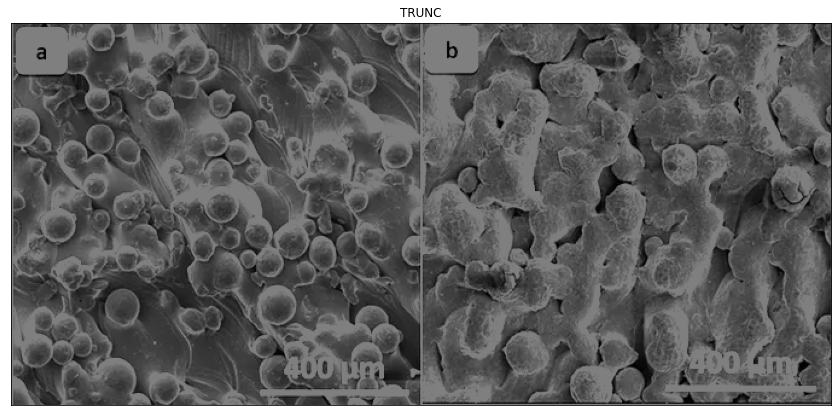

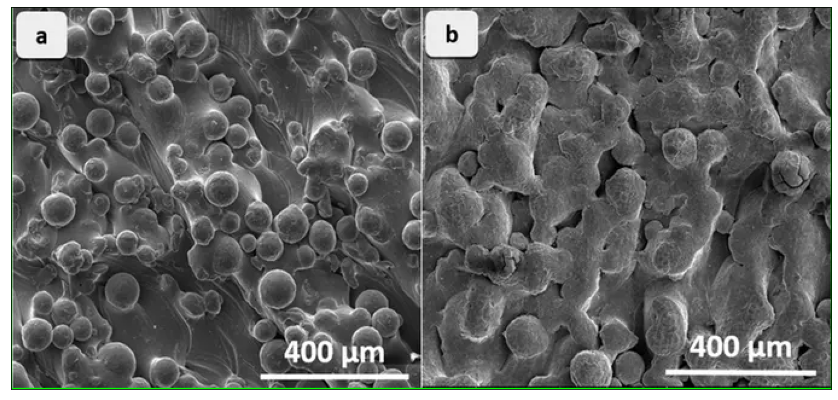

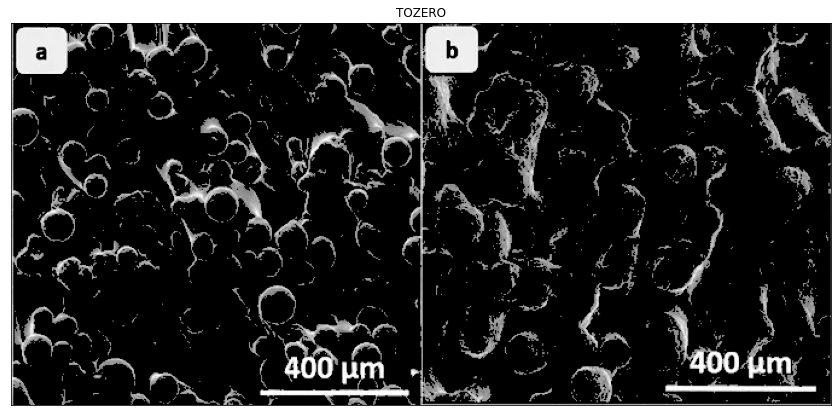

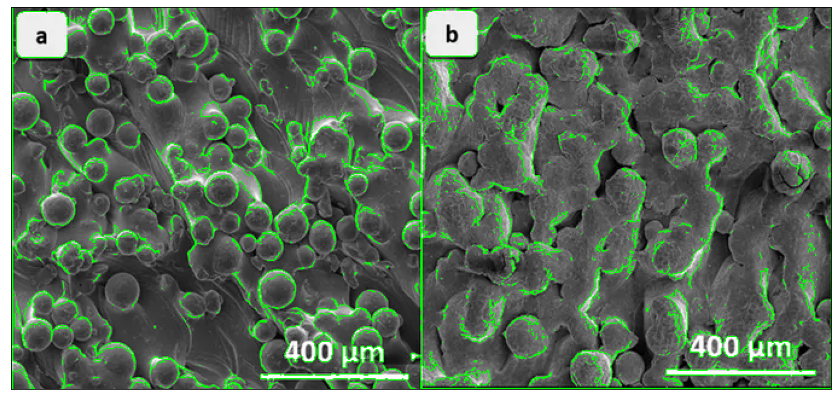

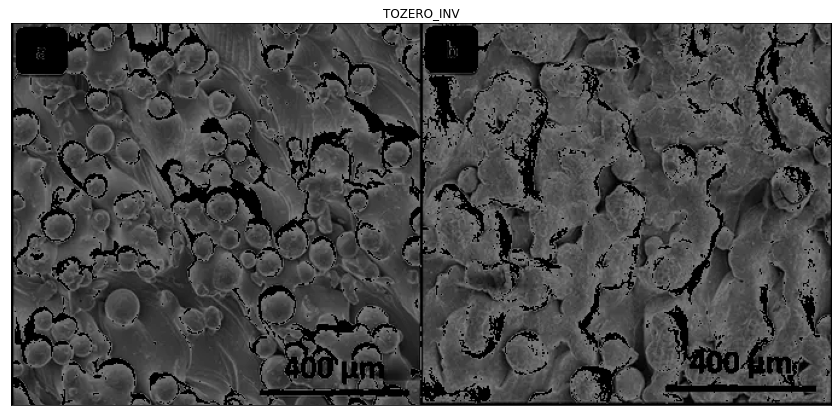

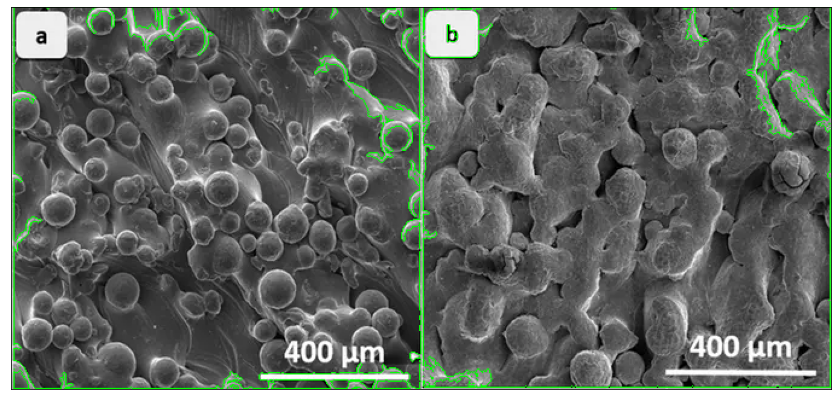

In [218]:
ret,thresh1 = cv.threshold(gray,127,255,cv.THRESH_BINARY)
ret,thresh2 = cv.threshold(gray,127,255,cv.THRESH_BINARY_INV)
ret,thresh3 = cv.threshold(gray,127,255,cv.THRESH_TRUNC)
ret,thresh4 = cv.threshold(gray,127,255,cv.THRESH_TOZERO)
ret,thresh5 = cv.threshold(gray,127,255,cv.THRESH_TOZERO_INV)
titles = ['BINARY','BINARY_INV','TRUNC','TOZERO','TOZERO_INV']
threshes = [thresh1, thresh2, thresh3, thresh4, thresh5]
images = [img.copy(), img.copy(), img.copy(), img.copy(), img.copy()]
for i in range(5):
    plt.figure(figsize=(50, 50))
    plt.subplot(2,3,i+1),plt.imshow(threshes[i],'gray',vmin=0,vmax=255)
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])
    contours, hierarchy = cv.findContours(threshes[i], cv.RETR_EXTERNAL, cv.CHAIN_APPROX_NONE)
    cv.drawContours(images[i], contours, -1, (0,255,0), 1)
#     print_image(images[i])
    plt.figure(figsize=(50, 50))
    plt.subplot(2,3,i+1),plt.imshow(images[i],'gray',vmin=0,vmax=255)
    plt.xticks([]),plt.yticks([])
plt.show()

Adaptive Thresholding:

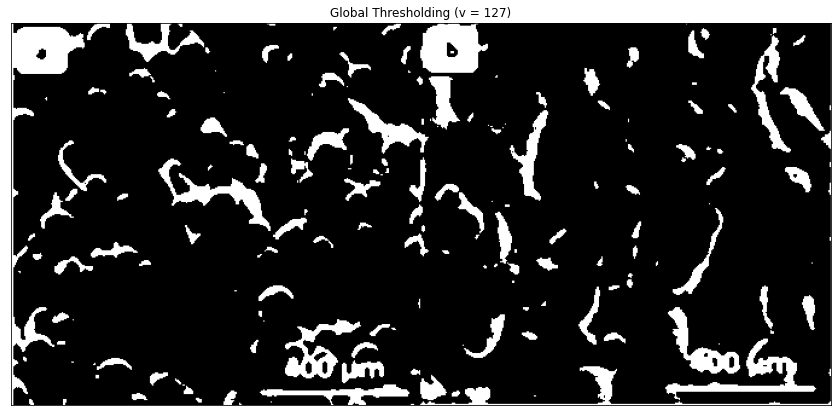

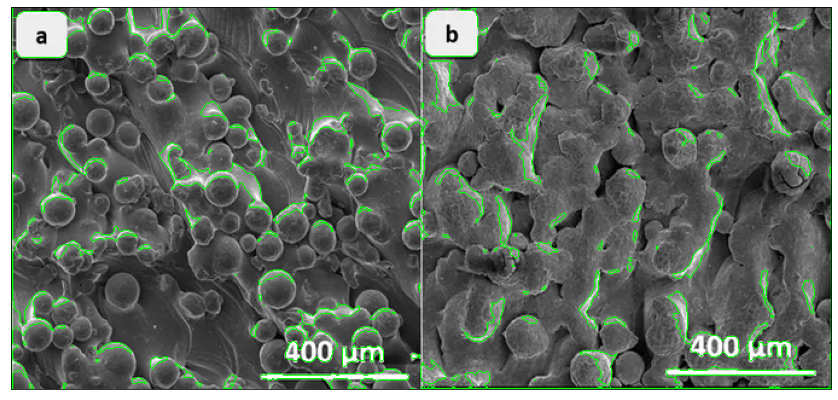

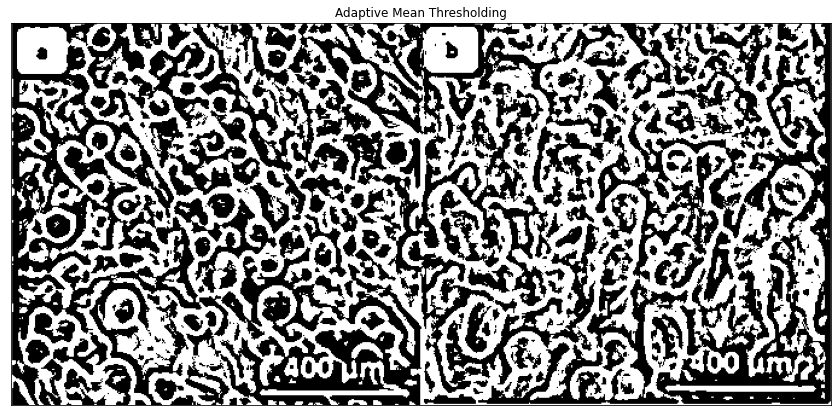

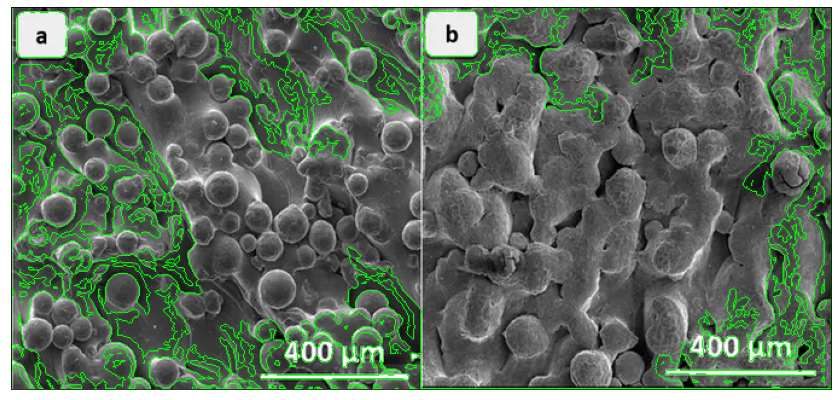

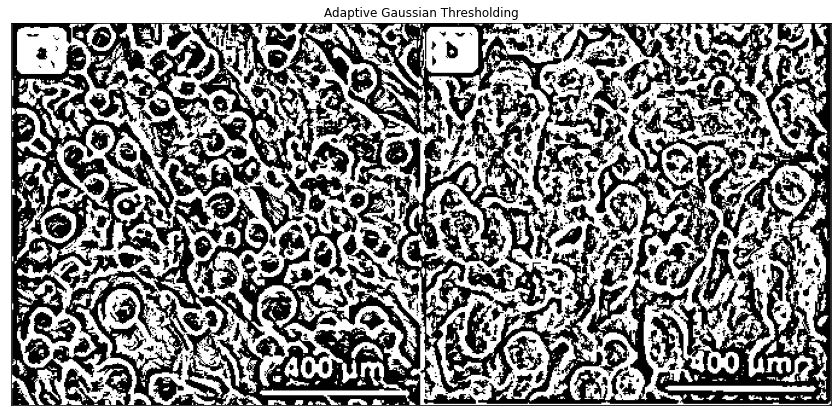

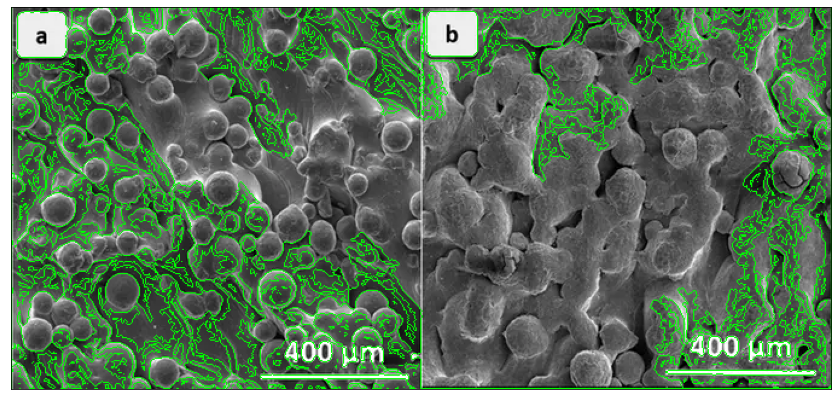

In [256]:
med_blur = cv.medianBlur(gray,5)
ret,th1 = cv.threshold(med_blur,127,255,cv.THRESH_BINARY)
th2 = cv.adaptiveThreshold(med_blur,255,cv.ADAPTIVE_THRESH_MEAN_C, cv.THRESH_BINARY,11,2)
th3 = cv.adaptiveThreshold(med_blur,255,cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY,11,1)
titles = ['Global Thresholding (v = 127)',
            'Adaptive Mean Thresholding', 'Adaptive Gaussian Thresholding']
threshes = [th1, th2, th3]
images = [img.copy(), img.copy(), img.copy()]
for i in range(3):
    plt.figure(figsize=(50, 50))
    plt.subplot(2,3,i+1),plt.imshow(threshes[i],'gray',vmin=0,vmax=255)
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])
    contours, hierarchy = cv.findContours(threshes[i], cv.RETR_EXTERNAL, cv.CHAIN_APPROX_NONE)
    cv.drawContours(images[i], contours, -1, (0,255,0), 1)
#     print_image(images[i])
    plt.figure(figsize=(50, 50))
    plt.subplot(2,3,i+1),plt.imshow(images[i],'gray',vmin=0,vmax=255)
    plt.xticks([]),plt.yticks([])
plt.show()

Otsu's Binarization:

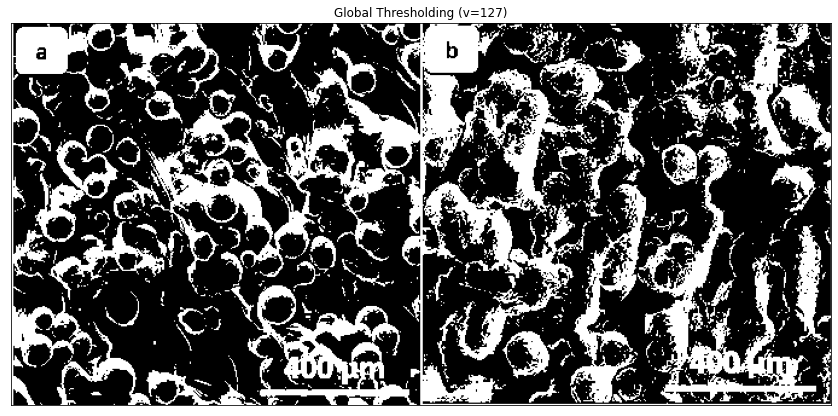

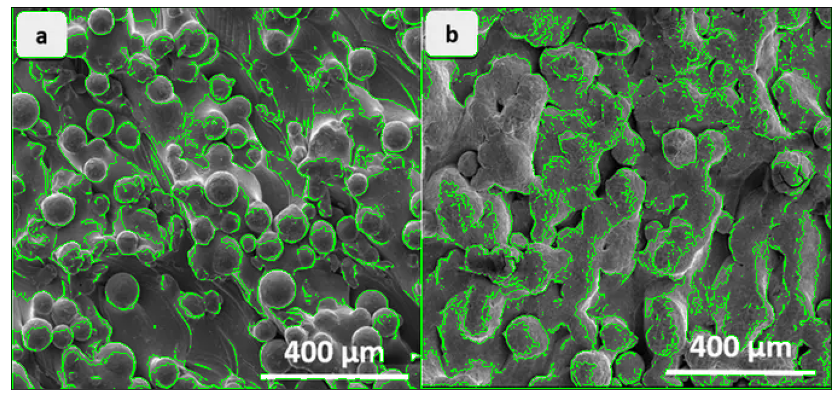

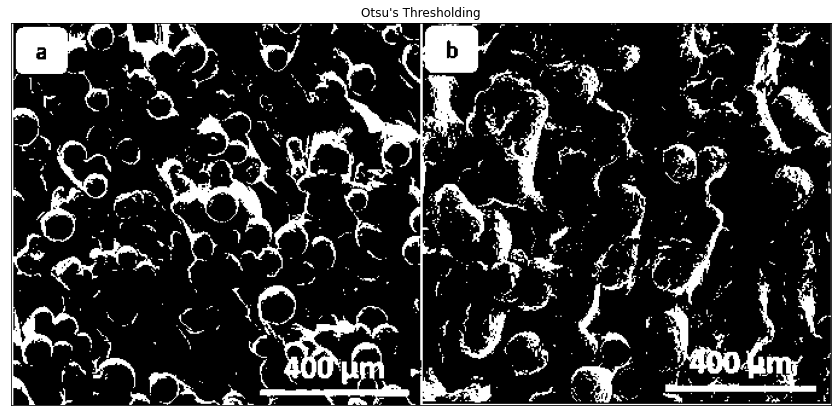

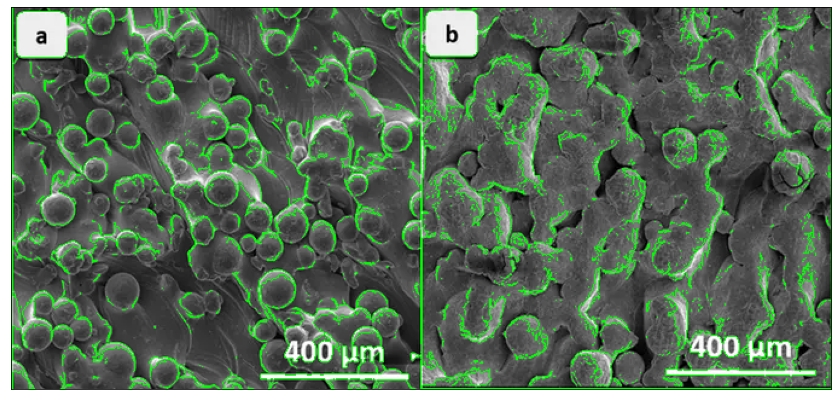

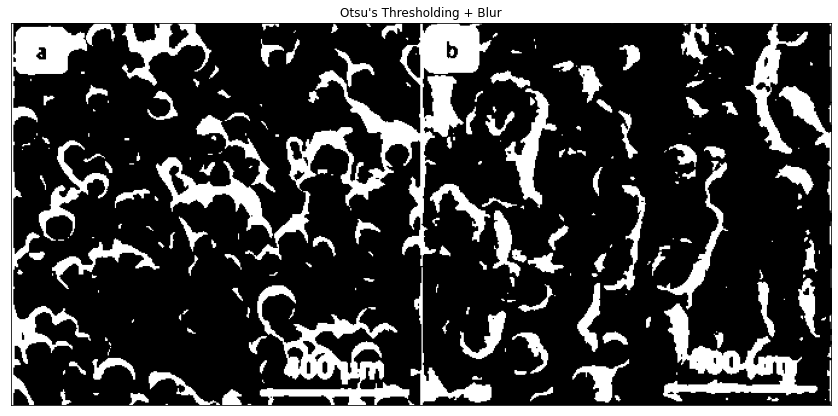

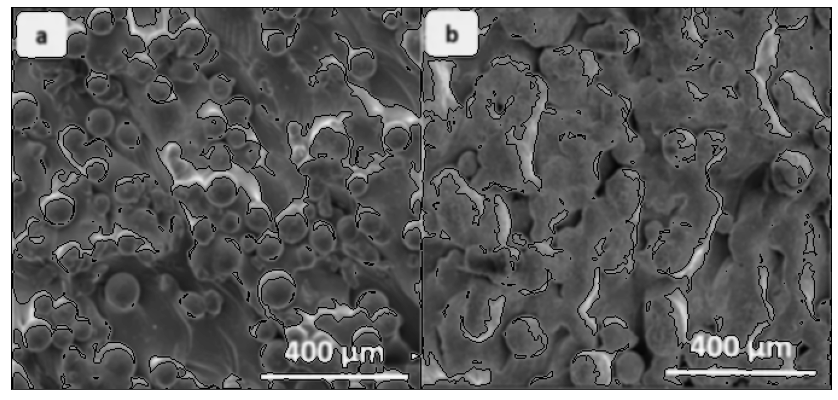

In [42]:
# global thresholding
ret1,th1 = cv.threshold(gray,100,255,cv.THRESH_BINARY)
# Otsu's thresholding
ret2,th2 = cv.threshold(gray,0,255,cv.THRESH_BINARY+cv.THRESH_OTSU)
# Otsu's thresholding after Gaussian filtering
blur = cv.GaussianBlur(gray,(5,5),0)
ret3,th3 = cv.threshold(blur,0,255,cv.THRESH_BINARY+cv.THRESH_OTSU)
# plot all the images and their histograms
images = [img.copy(), th1,
          img.copy(), th2,
          blur, th3]
titles = ['Global Thresholding (v=127)',
          "Otsu's Thresholding",
          "Otsu's Thresholding + Blur"]
for i in range(3):
    plt.figure(figsize=(50, 50))
    plt.subplot(2,3,i+1),plt.imshow(images[2 * i + 1],'gray',vmin=0,vmax=255)
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])
    contours, hierarchy = cv.findContours(images[2 * i + 1], cv.RETR_EXTERNAL, cv.CHAIN_APPROX_NONE)
    cv.drawContours(images[2 * i], contours, -1, (0,255,0), 1)
#     print_image(images[i])
    plt.figure(figsize=(50, 50))
    plt.subplot(2,3,i+1),plt.imshow(images[2 * i],'gray',vmin=0,vmax=255)
    plt.xticks([]),plt.yticks([])
plt.show()

Мне понравили результаты двух первых алгоритмов из Otsu's Binarization. Я решила немного поменять числа, при этом выделение контура изменялось как в лучшую, так и в худшую сторону. На самом деле правильный выбор константы будет сильно зависеть от яркости фотографии. Если я выберу этот способ, то нужно будет добавить опцию, при которой пользователь сможет менять константу.

# 3 неделя

Попробуем добавить к предыдущим функциям cv.Canny().

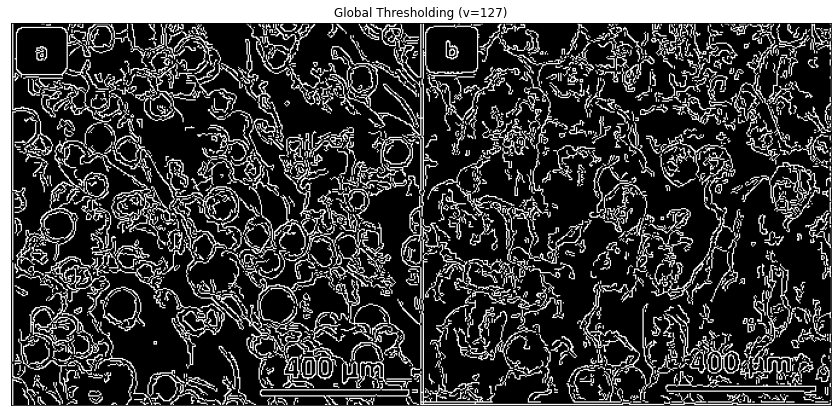

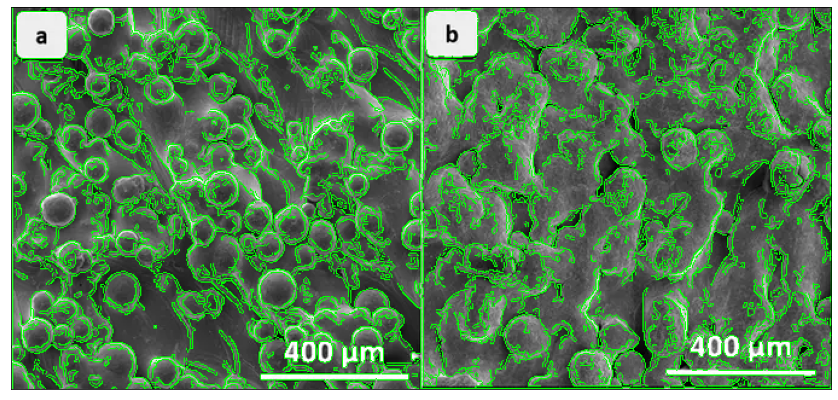

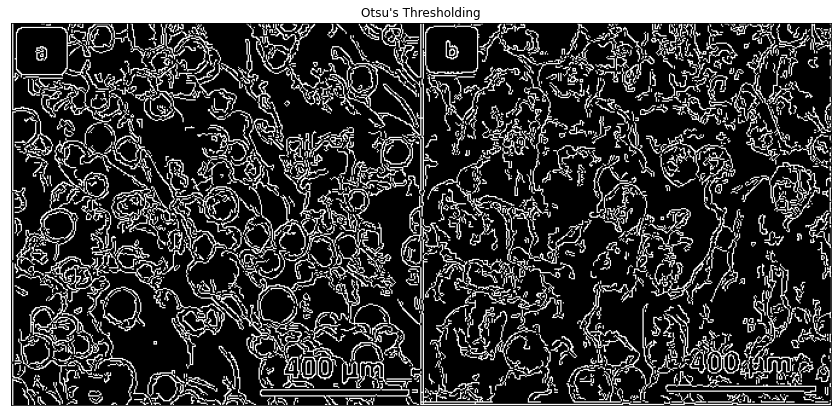

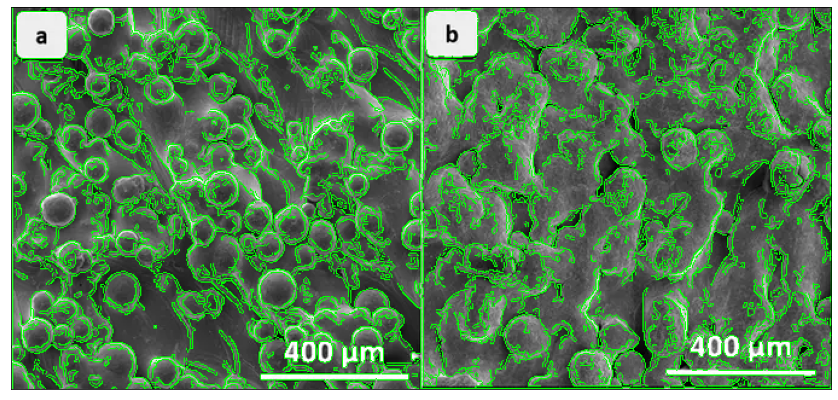

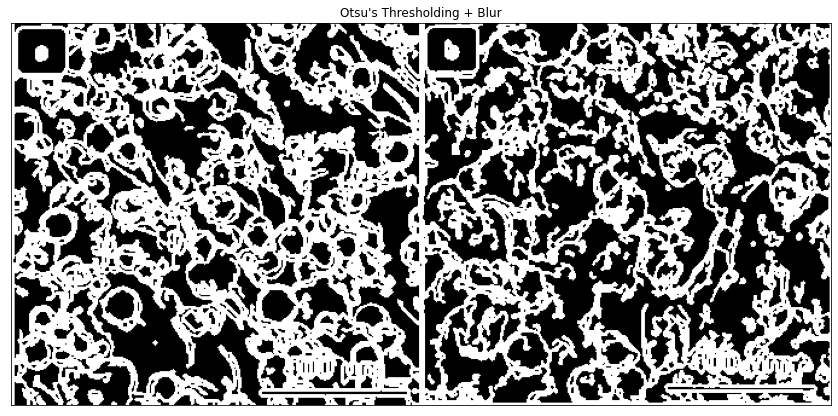

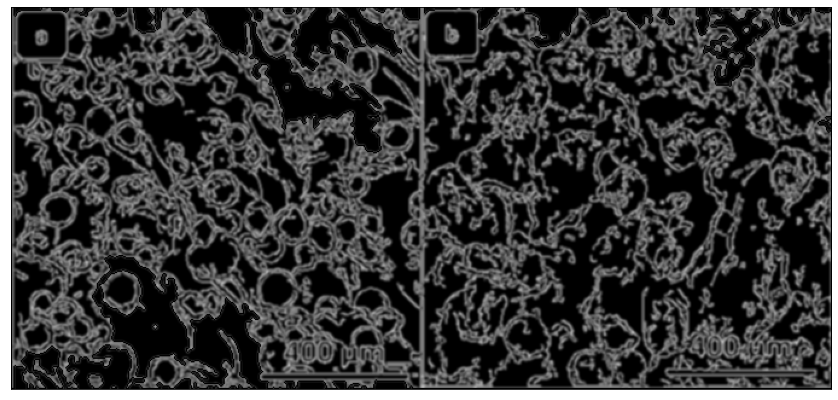

In [33]:
# global thresholding
gray3 = cv.cvtColor(clone3, cv.COLOR_BGR2GRAY)
gray3 = cv.Canny(gray3, 127, 255)
ret1,th1 = cv.threshold(gray3,127,255,cv.THRESH_BINARY)
# Otsu's thresholding
ret2,th2 = cv.threshold(gray3,0,255,cv.THRESH_BINARY+cv.THRESH_OTSU)
# Otsu's thresholding after Gaussian filtering
blur = cv.GaussianBlur(gray3,(5,5),0)
ret3,th3 = cv.threshold(blur,0,255,cv.THRESH_BINARY+cv.THRESH_OTSU)
# plot all the images and their histograms
images = [img.copy(), th1,
          img.copy(), th2,
          blur, th3]
titles = ['Global Thresholding (v=127)',
          "Otsu's Thresholding",
          "Otsu's Thresholding + Blur"]
for i in range(3):
    plt.figure(figsize=(50, 50))
    plt.subplot(2,3,i+1),plt.imshow(images[2 * i + 1],'gray',vmin=0,vmax=255)
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])
    contours, hierarchy = cv.findContours(images[2 * i + 1], cv.RETR_EXTERNAL, cv.CHAIN_APPROX_NONE)
    cv.drawContours(images[2 * i], contours, -1, (0,255,0), 1)
#     print_image(images[i])
    plt.figure(figsize=(50, 50))
    plt.subplot(2,3,i+1),plt.imshow(images[2 * i],'gray',vmin=0,vmax=255)
    plt.xticks([]),plt.yticks([])
plt.show()

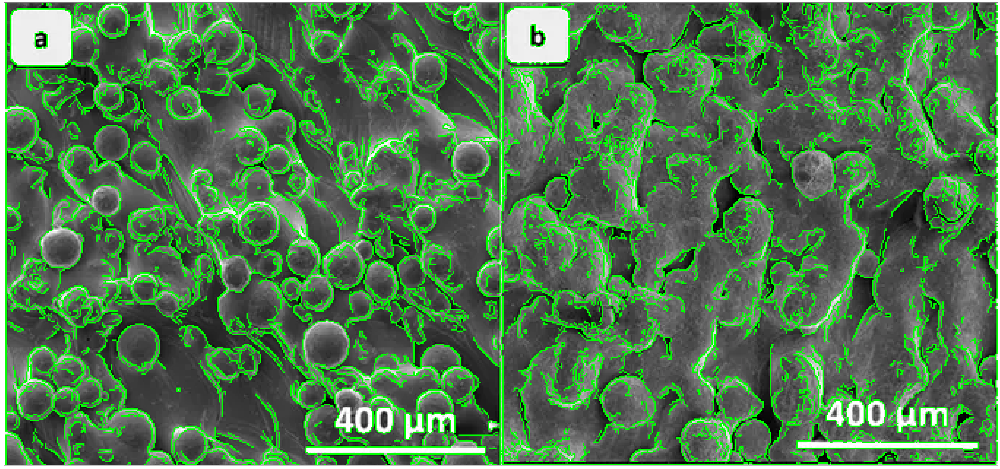

In [34]:
clone3 = img.copy()
gray2 = cv.cvtColor(clone3, cv.COLOR_BGR2GRAY)
gray2 = cv.Canny(gray2, 100, 200)
ret, thresh = cv.threshold(gray, 127, 255, 0)
contours, hierarchy = cv.findContours(thresh, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_NONE)
cv.drawContours(clone3, contours, -1, (0,255,0), 1)
print_image(clone3)

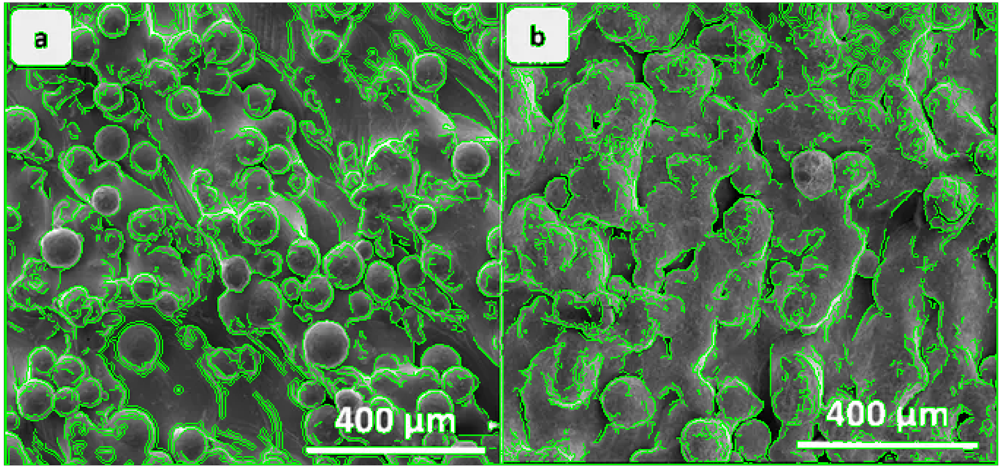

In [35]:
gray4 = cv.cvtColor(clone3, cv.COLOR_BGR2GRAY)
ret, thresh = cv.threshold(gray4, 127, 255, 0)
bil = cv.bilateralFilter(thresh, 5, 175, 175)
contours, hierarchy = cv.findContours(bil, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_NONE)
cv.drawContours(clone3, contours, -1, (0,255,0), 1)
print_image(clone3)